<a href="https://colab.research.google.com/github/RishiMahes/Machine-learning/blob/main/Copy_of_Eye_Disease_Final_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Dataset analysis

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import cv2
import random
from tqdm import tqdm
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/MiniProject2/Dataset/full_df.csv")
df.head()


,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg
2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",2_right.jpg
3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4_right.jpg
4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",5_right.jpg


In [ ]:
df['Left-Diagnostic Keywords'].unique()


array(['cataract', 'normal fundus',
       'laser spot，moderate non proliferative retinopathy',
       'macular epiretinal membrane',
       'moderate non proliferative retinopathy', 'drusen',
       'epiretinal membrane',
       'moderate non proliferative retinopathy，hypertensive retinopathy',
       'pathological myopia', 'mild nonproliferative retinopathy',
       'hypertensive retinopathy',
       'macular epiretinal membrane，mild nonproliferative retinopathy',
       'macular hole', 'wet age-related macular degeneration',
       'moderate non proliferative retinopathy，laser spot',
       'moderate non proliferative retinopathy，myelinated nerve fibers',
       'dry age-related macular degeneration',
       'epiretinal membrane，myelinated nerve fibers',
       'diabetic retinopathy', 'epiretinal membrane，lens dust', 'atrophy',
       'laser spot，white vessel，moderate non proliferative retinopathy',
       'chorioretinal atrophy',
       'moderate non proliferative retinopathy，catar

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
def has_cataract(text):
    if "cataract" in text:
        return 1
    else:
        return 0

In [ ]:
df["left_cataract"] = df["Left-Diagnostic Keywords"].apply(lambda x: has_cataract(x))
df["right_cataract"] = df["Right-Diagnostic Keywords"].apply(lambda x: has_cataract(x))

In [ ]:
def has_glaucoma(text):
    if "glaucoma" in text:
        return 1
    else:
        return 0

In [ ]:
df["left_glaucoma"] = df["Left-Diagnostic Keywords"].apply(lambda x: has_glaucoma(x))
df["right_glaucoma"] = df["Right-Diagnostic Keywords"].apply(lambda x: has_glaucoma(x))

In [ ]:
def has_diabetes(text):
    if "retinopathy" in text:
        return 1
    else:
        return 0

In [ ]:
df["left_diabetes"] = df["Left-Diagnostic Keywords"].apply(lambda x: has_diabetes(x))
df["right_diabetes"] = df["Right-Diagnostic Keywords"].apply(lambda x: has_diabetes(x))

In [ ]:
def has_hypertension(text):
    if "hypertensive" in text:
        return 1
    else:
        return 0

In [ ]:
df["left_hypertension"] = df["Left-Diagnostic Keywords"].apply(lambda x: has_hypertension(x))
df["right_hypertension"] = df["Right-Diagnostic Keywords"].apply(lambda x: has_hypertension(x))

In [ ]:
def has_amd(text):
    if "degeneration" in text:
        return 1
    else:
        return 0

In [ ]:
df["left_amd"] = df["Left-Diagnostic Keywords"].apply(lambda x: has_amd(x))
df["right_amd"] = df["Right-Diagnostic Keywords"].apply(lambda x: has_amd(x))

In [ ]:
def has_myopia(text):
    if "myopia" in text:
        return 1
    else:
        return 0

In [ ]:
df["left_myopia"] = df["Left-Diagnostic Keywords"].apply(lambda x: has_myopia(x))
df["right_myopia"] = df["Right-Diagnostic Keywords"].apply(lambda x: has_myopia(x))

In [ ]:
df.head()

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,...,left_glaucoma,right_glaucoma,left_diabetes,right_diabetes,left_hypertension,right_hypertension,left_amd,right_amd,left_myopia,right_myopia
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,...,0,0,1,1,0,0,0,0,0,0
3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,...,0,0,0,1,0,0,0,0,0,0
4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,...,0,0,1,1,0,0,0,0,0,0


In [ ]:
df['C'].value_counts()


C
0    5990
1     402
Name: count, dtype: int64

In [ ]:

df.left_glaucoma.value_counts()


left_glaucoma
0    6060
1     332
Name: count, dtype: int64

In [ ]:
df.right_glaucoma.value_counts()

right_glaucoma
0    6108
1     284
Name: count, dtype: int64

In [ ]:
left_cataract = df.loc[(df.C ==1) & (df.left_cataract == 1)]["Left-Fundus"].values
left_cataract[:15]

array(['0_left.jpg', '81_left.jpg', '103_left.jpg', '119_left.jpg',
       '254_left.jpg', '294_left.jpg', '330_left.jpg', '448_left.jpg',
       '465_left.jpg', '477_left.jpg', '553_left.jpg', '560_left.jpg',
       '594_left.jpg', '611_left.jpg', '625_left.jpg'], dtype=object)

In [ ]:
right_cataract = df.loc[(df.C ==1) & (df.right_cataract == 1)]["Right-Fundus"].values
right_cataract[:15]

array(['24_right.jpg', '81_right.jpg', '112_right.jpg', '188_right.jpg',
       '218_right.jpg', '345_right.jpg', '354_right.jpg', '477_right.jpg',
       '553_right.jpg', '560_right.jpg', '625_right.jpg', '726_right.jpg',
       '769_right.jpg', '949_right.jpg', '955_right.jpg'], dtype=object)

In [ ]:
left_glaucoma = df.loc[(df.G ==1) & (df.left_glaucoma == 1)]["Left-Fundus"].values
left_glaucoma[:15]

array(['95_left.jpg', '153_left.jpg', '167_left.jpg', '178_left.jpg',
       '247_left.jpg', '365_left.jpg', '583_left.jpg', '625_left.jpg',
       '746_left.jpg', '931_left.jpg', '1209_left.jpg', '1210_left.jpg',
       '1211_left.jpg', '1212_left.jpg', '1213_left.jpg'], dtype=object)

In [ ]:
right_glaucoma = df.loc[(df.G ==1) & (df.right_glaucoma == 1)]["Right-Fundus"].values
right_glaucoma[:15]

array(['43_right.jpg', '167_right.jpg', '238_right.jpg', '247_right.jpg',
       '365_right.jpg', '583_right.jpg', '746_right.jpg', '931_right.jpg',
       '1209_right.jpg', '1210_right.jpg', '1211_right.jpg',
       '1212_right.jpg', '1213_right.jpg', '1214_right.jpg',
       '1215_right.jpg'], dtype=object)

In [ ]:
left_diabetes = df.loc[(df.D ==1) & (df.left_diabetes == 1)]["Left-Fundus"].values
left_diabetes[:15]

array(['2_left.jpg', '5_left.jpg', '11_left.jpg', '19_left.jpg',
       '26_left.jpg', '37_left.jpg', '44_left.jpg', '46_left.jpg',
       '47_left.jpg', '49_left.jpg', '50_left.jpg', '64_left.jpg',
       '67_left.jpg', '71_left.jpg', '72_left.jpg'], dtype=object)

In [ ]:
right_diabetes = df.loc[(df.D ==1) & (df.right_diabetes == 1)]["Right-Fundus"].values
right_diabetes[:15]

array(['2_right.jpg', '4_right.jpg', '5_right.jpg', '6_right.jpg',
       '7_right.jpg', '11_right.jpg', '19_right.jpg', '26_right.jpg',
       '27_right.jpg', '44_right.jpg', '50_right.jpg', '54_right.jpg',
       '64_right.jpg', '67_right.jpg', '71_right.jpg'], dtype=object)

In [ ]:
left_hypertension = df.loc[(df.H ==1) & (df.left_hypertension == 1)]["Left-Fundus"].values
left_hypertension[:15]

array(['11_left.jpg', '23_left.jpg', '28_left.jpg', '32_left.jpg',
       '45_left.jpg', '62_left.jpg', '116_left.jpg', '120_left.jpg',
       '127_left.jpg', '139_left.jpg', '176_left.jpg', '179_left.jpg',
       '272_left.jpg', '296_left.jpg', '300_left.jpg'], dtype=object)

In [ ]:
right_hypertension = df.loc[(df.H ==1) & (df.right_hypertension == 1)]["Right-Fundus"].values
right_hypertension[:15]

array(['11_right.jpg', '23_right.jpg', '28_right.jpg', '32_right.jpg',
       '45_right.jpg', '62_right.jpg', '95_right.jpg', '116_right.jpg',
       '120_right.jpg', '127_right.jpg', '139_right.jpg', '176_right.jpg',
       '179_right.jpg', '272_right.jpg', '296_right.jpg'], dtype=object)

In [ ]:
left_amd = df.loc[(df.A ==1) & (df.left_amd == 1)]["Left-Fundus"].values
left_amd[:15]

array(['43_left.jpg', '48_left.jpg', '53_left.jpg', '55_left.jpg',
       '102_left.jpg', '126_left.jpg', '136_left.jpg', '152_left.jpg',
       '158_left.jpg', '162_left.jpg', '164_left.jpg', '168_left.jpg',
       '178_left.jpg', '210_left.jpg', '212_left.jpg'], dtype=object)

In [ ]:
right_amd = df.loc[(df.A ==1) & (df.right_amd == 1)]["Right-Fundus"].values
right_amd[:15]

array(['43_right.jpg', '48_right.jpg', '53_right.jpg', '55_right.jpg',
       '71_right.jpg', '102_right.jpg', '126_right.jpg', '152_right.jpg',
       '153_right.jpg', '158_right.jpg', '160_right.jpg', '162_right.jpg',
       '164_right.jpg', '168_right.jpg', '178_right.jpg'], dtype=object)

In [ ]:
left_myopia = df.loc[(df.M ==1) & (df.left_myopia == 1)]["Left-Fundus"].values
left_myopia[:15]

array(['13_left.jpg', '18_left.jpg', '35_left.jpg', '106_left.jpg',
       '144_left.jpg', '145_left.jpg', '174_left.jpg', '225_left.jpg',
       '379_left.jpg', '401_left.jpg', '481_left.jpg', '504_left.jpg',
       '525_left.jpg', '741_left.jpg', '771_left.jpg'], dtype=object)

In [ ]:
right_myopia= df.loc[(df.M ==1) & (df.right_myopia == 1)]["Right-Fundus"].values
right_myopia[:15]

array(['13_right.jpg', '16_right.jpg', '18_right.jpg', '46_right.jpg',
       '54_right.jpg', '86_right.jpg', '106_right.jpg', '145_right.jpg',
       '214_right.jpg', '233_right.jpg', '390_right.jpg', '401_right.jpg',
       '475_right.jpg', '504_right.jpg', '525_right.jpg'], dtype=object)

In [ ]:
print("Number of images in left cataract: {}".format(len(left_cataract)))
print("Number of images in right cataract: {}".format(len(right_cataract)))

Number of images in left cataract: 304
Number of images in right cataract: 290


In [ ]:
print("Number of images in left glaucoma: {}".format(len(left_glaucoma)))
print("Number of images in right glaucoma: {}".format(len(right_glaucoma)))

Number of images in left glaucoma: 332
Number of images in right glaucoma: 284


In [ ]:
left_normal = df.loc[(df.C ==0) & (df["Left-Diagnostic Keywords"] == "normal fundus")]["Left-Fundus"].sample(250,random_state=42).values
right_normal = df.loc[(df.C ==0) & (df["Right-Diagnostic Keywords"] == "normal fundus")]["Right-Fundus"].sample(250,random_state=42).values
right_normal[:15]

array(['2964_right.jpg', '680_right.jpg', '500_right.jpg',
       '2368_right.jpg', '2820_right.jpg', '2769_right.jpg',
       '2696_right.jpg', '2890_right.jpg', '940_right.jpg',
       '2553_right.jpg', '3371_right.jpg', '3042_right.jpg',
       '919_right.jpg', '3427_right.jpg', '379_right.jpg'], dtype=object)

In [ ]:
cataract = np.concatenate((left_cataract,right_cataract),axis=0)
glaucoma = np.concatenate((left_glaucoma,right_glaucoma),axis=0)
normal = np.concatenate((left_normal,right_normal),axis=0)
hypertension = np.concatenate((left_hypertension, right_hypertension), axis=0)
diabetes = np.concatenate((left_diabetes, right_diabetes), axis=0)
amd=np.concatenate((left_amd,right_amd),axis=0)
myopia=np.concatenate((left_myopia,right_myopia),axis=0)

In [ ]:
print(len(cataract),len(glaucoma),len(normal), len(hypertension), len(diabetes[:500]),len(amd),len(myopia))


594 616 500 382 500 551 479


In [ ]:
from tensorflow.keras.preprocessing.image import load_img,img_to_array
import os

dataset_dir = "/content/drive/MyDrive/MiniProject2/Dataset/preprocessed_images"
image_size=224
labels = []
dataset = []

def create_dataset(image_category,label):
    for img in tqdm(image_category):
        image_path = os.path.join(dataset_dir,img)
        try:
            image = cv2.imread(image_path,cv2.IMREAD_COLOR)
            image = cv2.resize(image,(image_size,image_size))
        except:
            continue

        dataset.append([np.array(image),np.array(label)])
    random.shuffle(dataset)
    return dataset

In [ ]:
dataset = create_dataset(cataract,1)

100%|██████████| 594/594 [02:11<00:00,  4.51it/s] 


In [ ]:
dataset = create_dataset(normal,0)

100%|██████████| 500/500 [02:22<00:00,  3.51it/s]


In [ ]:
dataset = create_dataset(glaucoma,2)

100%|██████████| 616/616 [01:30<00:00,  6.80it/s] 


In [ ]:
dataset = create_dataset(hypertension,3)

100%|██████████| 382/382 [00:53<00:00,  7.15it/s]


In [ ]:
dataset = create_dataset(diabetes[:500], 4)

100%|██████████| 500/500 [02:02<00:00,  4.07it/s]


In [ ]:
dataset = create_dataset(amd,5)

100%|██████████| 551/551 [01:18<00:00,  7.02it/s]


In [ ]:
dataset = create_dataset(myopia,6)

100%|██████████| 479/479 [01:12<00:00,  6.65it/s]


1724
705
3
3306
3307
146
78
958
906
2299


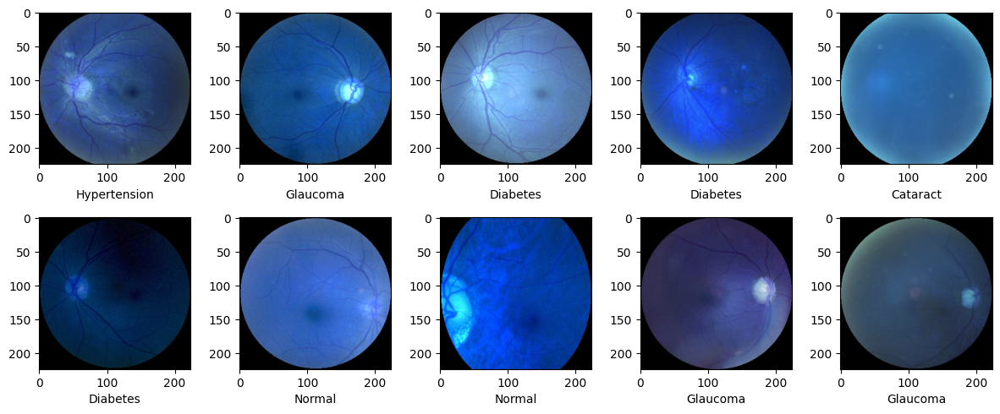

In [ ]:
plt.figure(figsize=(12,7))
for i in range(10):
    sample = random.choice(range(len(dataset)))
    print(sample)
    image = dataset[sample][0]
    category = dataset[sample][1]
    if category== 0:
        label = "Normal"
    elif category==2:
        label = "Glaucoma"
    elif category==1:
        label = "Cataract"

    elif category==3:
        label = "Hypertension"

    elif category==4:
        label = "Diabetes"

    elif category==6:
        label = "Myopia"
    plt.subplot(3,5,i+1)
    plt.imshow(image)
    plt.xlabel(label)
plt.tight_layout()

In [ ]:
x = np.array([i[0] for i in dataset]).reshape(-1,image_size,image_size,3)
y = np.array([i[1] for i in dataset])

In [ ]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.2,random_state=42,stratify=y)

# Inception

In [ ]:
import tensorflow as tf
from tensorflow.keras.applications.inception_v3 import InceptionV3

inception=tf.keras.applications.inception_v3.InceptionV3(
    include_top=False,
    weights='imagenet',
    input_tensor=None,
    input_shape=(224,224,3),
    pooling=None,
    classes=1000,
    classifier_activation='softmax'
)

In [ ]:
  for layer in inception.layers:
      layer.trainable = False

In [ ]:
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Flatten,Dense, MaxPooling2D
model_inception = Sequential()
model_inception.add(inception)
model_inception.add(Flatten())
model_inception.add(Dense(7,activation="softmax"))

In [ ]:
model_inception.compile(optimizer="adam",loss="sparse_categorical_crossentropy",metrics=["accuracy"])

In [ ]:
history = model_inception.fit(x_train,y_train,batch_size=32,epochs=100,validation_data=(x_test,y_test),
                    verbose=1)

Epoch 1/100
90/90 [==============================] - 22s 157ms/step - loss: 68.8475 - accuracy: 0.3431 - val_loss: 29.5173 - val_accuracy: 0.4603
Epoch 2/100
90/90 [==============================] - 8s 86ms/step - loss: 31.1848 - accuracy: 0.4691 - val_loss: 24.7396 - val_accuracy: 0.4965
Epoch 3/100
90/90 [==============================] - 8s 84ms/step - loss: 26.9514 - accuracy: 0.5264 - val_loss: 38.1844 - val_accuracy: 0.4728
Epoch 4/100
90/90 [==============================] - 8s 89ms/step - loss: 23.8628 - accuracy: 0.5665 - val_loss: 42.7010 - val_accuracy: 0.4338
Epoch 5/100
90/90 [==============================] - 8s 86ms/step - loss: 22.1004 - accuracy: 0.6143 - val_loss: 42.0161 - val_accuracy: 0.4951
Epoch 6/100
90/90 [==============================] - 7s 83ms/step - loss: 15.7802 - accuracy: 0.6775 - val_loss: 38.7049 - val_accuracy: 0.4561
Epoch 7/100
90/90 [==============================] - 9s 96ms/step - loss: 17.1594 - accuracy: 0.6733 - val_loss: 42.7895 - val_accurac

In [ ]:
model_inception.evaluate(x_test,y_test)

23/23 [==============================] - 2s 65ms/step - loss: 87.9385 - accuracy: 0.6848


[87.93853759765625, 0.6847977638244629]

In [ ]:
from sklearn.metrics import classification_report
y_pred = model_inception.predict(x_test)
preds = []
for i in y_pred:
  preds.append(np.argmax(i, axis=0))
print(classification_report(y_test, preds))

23/23 [==============================] - 3s 64ms/step
              precision    recall  f1-score   support

           0       0.53      0.33      0.41       100
           1       0.68      0.97      0.80       118
           2       0.62      0.89      0.73       123
           3       0.67      0.50      0.57        76
           4       0.50      0.42      0.46        95
           5       0.84      0.65      0.73       110
           6       0.94      0.89      0.92        95

    accuracy                           0.68       717
   macro avg       0.68      0.66      0.66       717
weighted avg       0.68      0.68      0.67       717



7/7 [==============================] - 3s 356ms/step


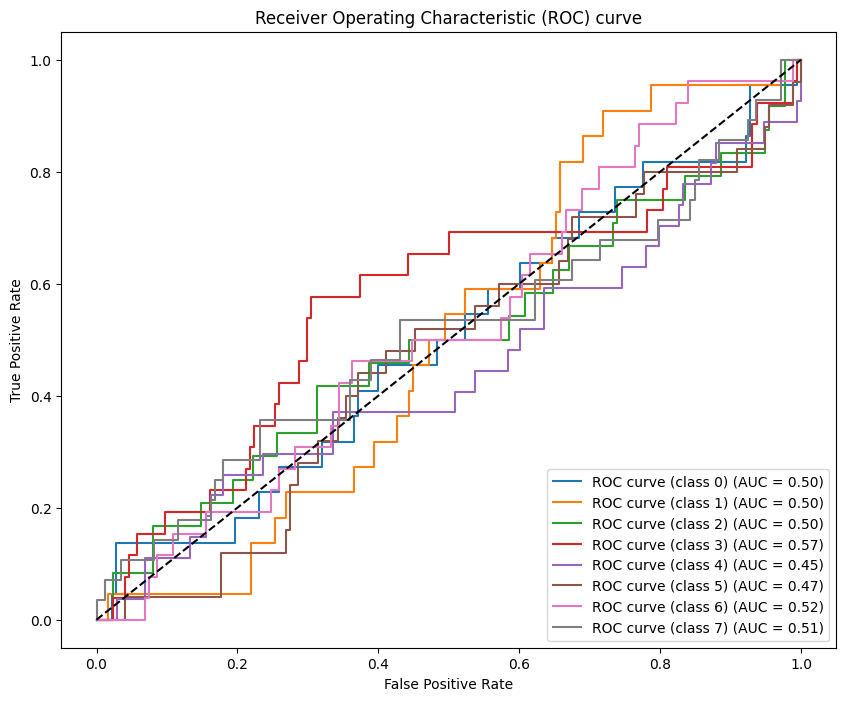

In [ ]:
import tensorflow as tf
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Flatten, Dense
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
import numpy as np


x = np.random.rand(1000, 224, 224, 3)
y = np.random.randint(8, size=(1000,))

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42, stratify=y)

inception = tf.keras.applications.inception_v3.InceptionV3(
    include_top=False,
    weights='imagenet',
    input_tensor=None,
    input_shape=(224,224,3),
    pooling=None,
    classes=1000,
    classifier_activation='softmax'
)


for layer in inception.layers:
    layer.trainable = False

model_inception = Sequential()
model_inception.add(inception)
model_inception.add(Flatten())
model_inception.add(Dense(8, activation="softmax"))  # Change the number of classes to 8

model_inception.compile(optimizer="adam", loss="sparse_categorical_crossentropy", metrics=["accuracy"])

y_pred_proba = model_inception.predict(x_test)

fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(8):
    fpr[i], tpr[i], _ = roc_curve(y_test == i, y_pred_proba[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

plt.figure(figsize=(10, 8))
for i in range(8):
    plt.plot(fpr[i], tpr[i], label='ROC curve (class %d) (AUC = %0.2f)' % (i, roc_auc[i]))
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) curve')
plt.legend(loc="lower right")
plt.show()


# ResNet-50

In [ ]:
from tensorflow.keras.applications.resnet50 import ResNet50
resnet = ResNet50(weights="imagenet",include_top = False,input_shape=(image_size,image_size,3))

In [ ]:
for layer in resnet.layers:
    layer.trainable = False

In [ ]:
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Flatten,Dense, MaxPooling2D
model = Sequential()
model.add(resnet)
model.add(Flatten())
model.add(Dense(7,activation="softmax"))

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 flatten (Flatten)           (None, 100352)            0         
                                                                 
 dense (Dense)               (None, 7)                 702471    
                                                                 
Total params: 24290183 (92.66 MB)
Trainable params: 702471 (2.68 MB)
Non-trainable params: 23587712 (89.98 MB)
_________________________________________________________________


In [ ]:
model.compile(optimizer="Adam",loss="sparse_categorical_crossentropy",metrics=["accuracy"])

In [ ]:
history = model.fit(x_train,y_train,batch_size=32,epochs=30,validation_data=(x_test,y_test),
                    verbose=1)

Epoch 1/30
90/90 [==============================] - 24s 177ms/step - loss: 8.1832 - accuracy: 0.5312 - val_loss: 4.5760 - val_accuracy: 0.6262
Epoch 2/30
90/90 [==============================] - 10s 112ms/step - loss: 2.5168 - accuracy: 0.7679 - val_loss: 4.7939 - val_accuracy: 0.6611
Epoch 3/30
90/90 [==============================] - 10s 114ms/step - loss: 2.0775 - accuracy: 0.8255 - val_loss: 5.5082 - val_accuracy: 0.6778
Epoch 4/30
90/90 [==============================] - 10s 115ms/step - loss: 1.9546 - accuracy: 0.8471 - val_loss: 6.6197 - val_accuracy: 0.6764
Epoch 5/30
90/90 [==============================] - 10s 116ms/step - loss: 1.8587 - accuracy: 0.8754 - val_loss: 5.8905 - val_accuracy: 0.7197
Epoch 6/30
90/90 [==============================] - 11s 118ms/step - loss: 1.7498 - accuracy: 0.8782 - val_loss: 4.9301 - val_accuracy: 0.7406
Epoch 7/30
90/90 [==============================] - 11s 125ms/step - loss: 1.8605 - accuracy: 0.8914 - val_loss: 7.0565 - val_accuracy: 0.7169

In [ ]:
model.evaluate(x_test, y_test)

23/23 [==============================] - 2s 92ms/step - loss: 10.7266 - accuracy: 0.7671


[10.726591110229492, 0.767085075378418]

In [ ]:
from sklearn.metrics import classification_report
y_pred = model.predict(x_test)
preds = []
for i in y_pred:
  preds.append(np.argmax(i, axis=0))
print(classification_report(y_test, preds))

10/10 [==============================] - 3s 97ms/step
              precision    recall  f1-score   support

           0       0.48      0.56      0.52        43
           1       0.72      0.96      0.82        50
           2       0.73      0.84      0.78        51
           3       0.66      0.59      0.62        32
           4       0.33      0.09      0.14        44
           5       0.71      0.76      0.73        45
           6       0.90      0.90      0.90        40

    accuracy                           0.68       305
   macro avg       0.65      0.67      0.65       305
weighted avg       0.65      0.68      0.65       305



In [ ]:
model.save("/content/drive/MyDrive/MiniProject/archive (2)/resnetadam")

23/23 [==============================] - 6s 95ms/step


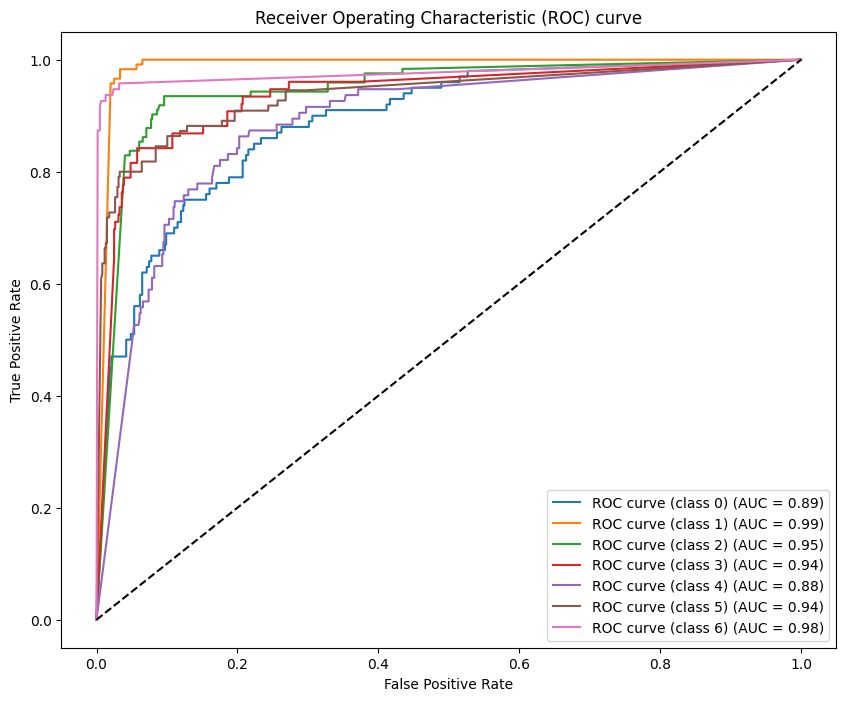

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from tensorflow.keras.utils import to_categorical

y_pred_proba = model.predict(x_test)

y_test_one_hot = to_categorical(y_test)

fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(7):
    fpr[i], tpr[i], _ = roc_curve(y_test_one_hot[:, i], y_pred_proba[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

plt.figure(figsize=(10, 8))
for i in range(7):
    plt.plot(fpr[i], tpr[i], label='ROC curve (class %d) (AUC = %0.2f)' % (i, roc_auc[i]))
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) curve')
plt.legend(loc="lower right")
plt.show()


# Alex Net

In [ ]:

import keras
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout, Flatten, Conv2D, MaxPooling2D
from keras.layers import BatchNormalization
import numpy as np

np.random.seed(1000)

In [ ]:
AlexNet = Sequential()


In [ ]:
AlexNet.add(Conv2D(filters=96, input_shape=(32,32,3), kernel_size=(11,11), strides=(4,4), padding='same'))
AlexNet.add(BatchNormalization())
AlexNet.add(Activation('relu'))
AlexNet.add(MaxPooling2D(pool_size=(2,2), strides=(2,2), padding='same'))
AlexNet.add(Conv2D(filters=256, kernel_size=(5, 5), strides=(1,1), padding='same'))
AlexNet.add(BatchNormalization())
AlexNet.add(Activation('relu'))
AlexNet.add(MaxPooling2D(pool_size=(2,2), strides=(2,2), padding='same'))

AlexNet.add(Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), padding='same'))
AlexNet.add(BatchNormalization())
AlexNet.add(Activation('relu'))

AlexNet.add(Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), padding='same'))
AlexNet.add(BatchNormalization())
AlexNet.add(Activation('relu'))

AlexNet.add(Conv2D(filters=256, kernel_size=(3,3), strides=(1,1), padding='same'))
AlexNet.add(BatchNormalization())
AlexNet.add(Activation('relu'))
AlexNet.add(MaxPooling2D(pool_size=(2,2), strides=(2,2), padding='same'))

In [ ]:
AlexNet.add(Flatten())

AlexNet.add(Dense(4096, input_shape=(32,32,3,)))
AlexNet.add(BatchNormalization())
AlexNet.add(Activation('relu'))

AlexNet.add(Dropout(0.4))


AlexNet.add(Dense(4096))
AlexNet.add(BatchNormalization())
AlexNet.add(Activation('relu'))

AlexNet.add(Dropout(0.4))


AlexNet.add(Dense(1000))
AlexNet.add(BatchNormalization())
AlexNet.add(Activation('relu'))

AlexNet.add(Dropout(0.4))


AlexNet.add(Dense(10))
AlexNet.add(BatchNormalization())
AlexNet.add(Activation('softmax'))


In [ ]:

AlexNet.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 8, 8, 96)          34944     
                                                                 
 batch_normalization (Batch  (None, 8, 8, 96)          384       
 Normalization)                                                  
                                                                 
 activation (Activation)     (None, 8, 8, 96)          0         
                                                                 
 max_pooling2d (MaxPooling2  (None, 4, 4, 96)          0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 4, 4, 256)         614656    
                                                                 
 batch_normalization_1 (Bat  (None, 4, 4, 256)         1

In [ ]:
AlexNet.compile(loss = keras.losses.categorical_crossentropy, optimizer= 'adam', metrics=['accuracy'])

In [ ]:

from keras.datasets import cifar10
(x_train, y_train),(x_test, y_test)=cifar10.load_data()


170498071/170498071 [==============================] - 3s 0us/step


In [ ]:

from sklearn.model_selection import train_test_split
x_train,x_val,y_train,y_val=train_test_split(x_train,y_train,test_size=.3)


In [ ]:

print((x_train.shape,y_train.shape))
print((x_val.shape,y_val.shape))
print((x_test.shape,y_test.shape))

((35000, 32, 32, 3), (35000, 1))
((15000, 32, 32, 3), (15000, 1))
((10000, 32, 32, 3), (10000, 1))


In [ ]:

from sklearn.utils.multiclass import unique_labels
from keras.utils import to_categorical

In [ ]:

y_train=to_categorical(y_train)
y_val=to_categorical(y_val)
y_test=to_categorical(y_test)

In [ ]:

print((x_train.shape,y_train.shape))
print((x_val.shape,y_val.shape))
print((x_test.shape,y_test.shape))


((35000, 32, 32, 3), (35000, 10))
((15000, 32, 32, 3), (15000, 10))
((10000, 32, 32, 3), (10000, 10))


In [ ]:

from keras.preprocessing.image import ImageDataGenerator

In [ ]:
train_generator = ImageDataGenerator(rotation_range=2, horizontal_flip=True,zoom_range=.1 )

val_generator = ImageDataGenerator(rotation_range=2, horizontal_flip=True,zoom_range=.1)

test_generator = ImageDataGenerator(rotation_range=2, horizontal_flip= True,zoom_range=.1)

In [ ]:
train_generator.fit(x_train)
val_generator.fit(x_val)
test_generator.fit(x_test)

In [ ]:

batch_size = 100
epochs = 100

In [ ]:
history = AlexNet.fit(train_generator.flow(x_train, y_train, batch_size=batch_size),
                      epochs=epochs,
                      steps_per_epoch=x_train.shape[0] // batch_size,
                      validation_data=val_generator.flow(x_val, y_val, batch_size=batch_size),
                      validation_steps=250,
                      verbose=1)

Epoch 1/100
350/350 [==============================] - ETA: 0s - loss: 1.6421 - accuracy: 0.4097

350/350 [==============================] - 44s 92ms/step - loss: 1.6421 - accuracy: 0.4097 - val_loss: 2.0250 - val_accuracy: 0.2716
Epoch 2/100
350/350 [==============================] - 20s 57ms/step - loss: 1.3901 - accuracy: 0.5137
Epoch 3/100
350/350 [==============================] - 25s 72ms/step - loss: 1.2796 - accuracy: 0.5540
Epoch 4/100
350/350 [==============================] - 23s 66ms/step - loss: 1.1859 - accuracy: 0.5873
Epoch 5/100
350/350 [==============================] - 22s 62ms/step - loss: 1.1213 - accuracy: 0.6117
Epoch 6/100
350/350 [==============================] - 20s 58ms/step - loss: 1.0538 - accuracy: 0.6387
Epoch 7/100
350/350 [==============================] - 22s 63ms/step - loss: 1.0092 - accuracy: 0.6539
Epoch 8/100
350/350 [==============================] - 20s 58ms/step - loss: 0.9700 - accuracy: 0.6683
Epoch 9/100
350/350 [==============================] - 22s 62ms/step - loss: 0.9187 - accuracy: 0.6837
Epoch 10/100
350/350 [=====================

In [ ]:
from sklearn.metrics import classification_report

# Predict classes on the test data
y_pred = np.argmax(AlexNet.predict(x_test), axis=-1)

# Convert one-hot encoded labels back to integers
y_true = np.argmax(y_test, axis=-1)

# Generate classification report
report = classification_report(y_true, y_pred)

print(report)


313/313 [==============================] - 2s 5ms/step
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.62      0.71      1000
           1       0.83      0.77      0.80      1000
           2       0.48      0.71      0.57      1000
           3       0.58      0.33      0.42      1000
           4       0.69      0.50      0.58      1000
           5       0.50      0.71      0.59      1000
           6       0.63      0.85      0.72      1000
           7       0.88      0.57      0.69      1000
           8       0.87      0.74      0.80      1000
           9       0.64      0.83      0.72      1000
Accuracy: 0.66
Macro Average Accuracy: 0.66
Weighted Average Accuracy: 0.66


313/313 [==============================] - 2s 4ms/step


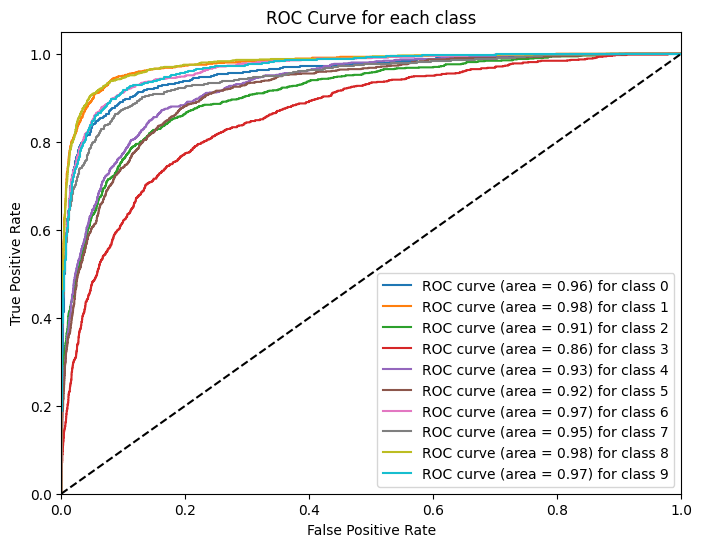

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

y_pred = AlexNet.predict(x_test)

fpr = dict()
tpr = dict()
roc_auc = dict()
num_classes = 10
for i in range(num_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
plt.figure(figsize=(8, 6))
for i in range(num_classes):
    plt.plot(fpr[i], tpr[i], label='ROC curve (area = %0.2f) for class %d' % (roc_auc[i], i))
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for each class')
plt.legend(loc="lower right")
plt.show()


In [ ]:
df = pd.read_csv("/content/drive/MyDrive/MiniProject2/Dataset/full_df.csv")
df.head()

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg
2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",2_right.jpg
3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4_right.jpg
4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",5_right.jpg


In [ ]:
classes = { 0: "Normal",
            1: "Diabetes",
            2: "Glaucoma",
            3: "Cataract",
            4: "Age related Macular Degeneration",
            5: "Hypertension",
            6: "Pathological Myopia",
            7: "Other diseases/abnormalities"
          }

In [ ]:
import json

In [ ]:
df.head()

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg
2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",2_right.jpg
3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4_right.jpg
4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",5_right.jpg


In [ ]:
targets = np.array(df["target"].apply(lambda x: json.loads(x)).tolist())
targets.shape

(6392, 8)

In [ ]:
df["class_name"] = np.argmax(targets, axis=1).tolist()
df["class_name"] = df["class_name"] .replace(classes)
df.head()

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename,class_name
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg,Normal
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg,Normal
2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",2_right.jpg,Diabetes
3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4_right.jpg,Diabetes
4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",5_right.jpg,Diabetes


In [ ]:
data_cleaned = df[["ID",  "filename", "class_name", "target"]]
data_cleaned.to_csv("/content/drive/MyDrive/MiniProject2/data_cleaned.csv", index=False)

In [ ]:
data_cleaned.head()

,ID,filename,class_name,target
0,0,0_right.jpg,Normal,"[1, 0, 0, 0, 0, 0, 0, 0]"
1,1,1_right.jpg,Normal,"[1, 0, 0, 0, 0, 0, 0, 0]"
2,2,2_right.jpg,Diabetes,"[0, 1, 0, 0, 0, 0, 0, 0]"
3,4,4_right.jpg,Diabetes,"[0, 1, 0, 0, 0, 0, 0, 0]"
4,5,5_right.jpg,Diabetes,"[0, 1, 0, 0, 0, 0, 0, 0]"


In [ ]:
import os
fullname = []
processed = "/content/drive/MyDrive/MiniProject/archive (2)/preprocessed_images"
for i in data_cleaned['filename']:
  fullname.append(os.path.join(processed, i))len(fullname)

In [ ]:
len(fullname)

6392

In [ ]:
data_cleaned['fullname'] = fullname

<ipython-input-59-0a2d6cb9e081>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_cleaned['fullname'] = fullname


In [ ]:
data_cleaned['class_name'].value_counts()

class_name
Normal                              2873
Diabetes                            1608
Other diseases/abnormalities         708
Cataract                             293
Glaucoma                             284
Age related Macular Degeneration     266
Pathological Myopia                  232
Hypertension                         128
Name: count, dtype: int64

In [ ]:
images = []
classes = []
y = data_cleaned['class_name']
class_count = {
"Normal"                           :   0,
"Diabetes"                           : 0,
"Other diseases/abnormalities"        : 0,
"Cataract"                            : 0,
"Glaucoma"                            : 0,
"Age related Macular Degeneration"    : 0,
"Pathological Myopia"                 : 0,
"Hypertension"                        : 0
}
for i in range(len(y)):
  if class_count[y[i]] <= 127:
    images.append(data_cleaned['filename'][i])
    classes.append(data_cleaned['class_name'][i])
    class_count[y[i]]+=1
print(class_count)


{'Normal': 128, 'Diabetes': 128, 'Other diseases/abnormalities': 128, 'Cataract': 128, 'Glaucoma': 128, 'Age related Macular Degeneration': 128, 'Pathological Myopia': 128, 'Hypertension': 128}


In [ ]:
downsample_data = pd.DataFrame()
downsample_data['fullname'] = images
downsample_data['class'] = classes
downsample_data.head()

,fullname,class
0,0_right.jpg,Normal
1,1_right.jpg,Normal
2,2_right.jpg,Diabetes
3,4_right.jpg,Diabetes
4,5_right.jpg,Diabetes


In [ ]:
downsample_data.to_csv("/content/drive/MyDrive/MiniProject2/downsample.csv", index=False)

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
train_datagen = ImageDataGenerator(rescale=1./255)
X_train, X_test, y_train, y_test = train_test_split(downsample_data['fullname'], downsample_data['class'], test_size=0.2, random_state=42)
data_train = pd.DataFrame()
data_train['images'] = X_train
data_train['labels'] = y_train
data_test = pd.DataFrame()
data_test['images'] = X_test
data_test['labels'] = y_test
data_test.to_csv("/content/drive/MyDrive/MiniProject2/downtest.csv", index=False)
train_dir = '/content/drive/MyDrive/MiniProject2/Dataset/preprocessed_images'
train_generator = train_datagen.flow_from_dataframe(downsample_data, directory = train_dir, x_col ="fullname", y_col="class", class_mode="categorical", shuffle=True, target_size=(224, 224))
valid_generator = train_datagen.flow_from_dataframe(data_test, directory = train_dir, x_col ="images", y_col="labels", class_mode="categorical", shuffle=False, target_size=(224, 224))

Found 1024 validated image filenames belonging to 8 classes.
Found 205 validated image filenames belonging to 8 classes.


In [ ]:
valid_generator = train_datagen.flow_from_dataframe(data_test, directory = train_dir, x_col ="images", y_col="labels", class_mode="categorical", shuffle=False, target_size=(224, 224))

Found 205 validated image filenames belonging to 8 classes.


# Mobilenet

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
m = tf.keras.Sequential([
    hub.KerasLayer("https://tfhub.dev/google/imagenet/mobilenet_v2_035_224/classification/5"),
    tf.keras.layers.Dense(units = 8,activation="softmax")
])
m.compile(loss = tf.keras.losses.CategoricalCrossentropy(),
                optimizer = tf.keras.optimizers.Adam(),
                metrics = ["accuracy"])
batch_size = 16

In [ ]:
m.fit(train_generator, epochs=100)

Epoch 1/100
32/32 [==============================] - 158s 5s/step - loss: 2.1853 - accuracy: 0.3252
Epoch 2/100
32/32 [==============================] - 6s 192ms/step - loss: 1.4781 - accuracy: 0.4424
Epoch 3/100
32/32 [==============================] - 7s 210ms/step - loss: 1.3492 - accuracy: 0.4775
Epoch 4/100
32/32 [==============================] - 6s 189ms/step - loss: 1.3169 - accuracy: 0.4961
Epoch 5/100
32/32 [==============================] - 6s 192ms/step - loss: 1.2245 - accuracy: 0.5459
Epoch 6/100
32/32 [==============================] - 7s 205ms/step - loss: 1.1576 - accuracy: 0.5498
Epoch 7/100
32/32 [==============================] - 6s 188ms/step - loss: 1.1740 - accuracy: 0.5508
Epoch 8/100
32/32 [==============================] - 7s 205ms/step - loss: 1.1494 - accuracy: 0.5605
Epoch 9/100
32/32 [==============================] - 6s 191ms/step - loss: 1.0730 - accuracy: 0.6143
Epoch 10/100
32/32 [==============================] - 6s 186ms/step - loss: 1.0520 - accurac

In [ ]:
m.evaluate(train_generator)

32/32 [==============================] - 11s 329ms/step - loss: 0.4359 - accuracy: 0.8818


[0.43593630194664, 0.8818359375]

In [ ]:
from sklearn.metrics import classification_report
y_pred = m.predict(valid_generator)
preds = []
for i in y_pred:
  preds.append(np.argmax(i, axis=0))
print(classification_report(valid_generator.classes, preds))

7/7 [==============================] - 3s 371ms/step
              precision    recall  f1-score   support

           0       1.00      0.91      0.95        23
           1       1.00      1.00      1.00        29
           2       0.76      0.88      0.81        25
           3       1.00      0.96      0.98        27
           4       0.92      0.92      0.92        25
           5       0.86      0.97      0.91        32
           6       0.93      0.68      0.79        19
           7       1.00      1.00      1.00        25

    accuracy                           0.93       205
   macro avg       0.93      0.92      0.92       205
weighted avg       0.93      0.93      0.93       205



# Grad Cam Implementation

RESNET

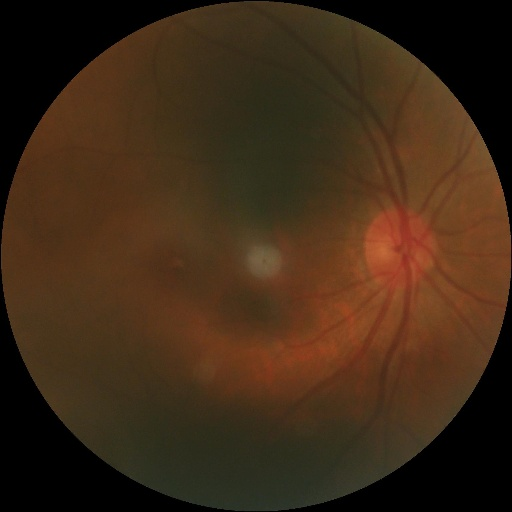

In [ ]:
import tensorflow as tf
import numpy as np
import keras
from keras.preprocessing import image
from keras.applications.resnet50 import ResNet50, preprocess_input, decode_predictions
from IPython.display import Image, display


model = ResNet50(weights='imagenet')


last_conv_layer_name = "conv5_block3_out"


img_path = "/content/drive/MyDrive/MiniProject2/Dataset/preprocessed_images/0_right.jpg"
display(Image(img_path))

def get_img_array(img_path, size):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return preprocess_input(array)

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, last_conv_layer_output)

    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

img_size = (224, 224)
img_array = get_img_array(img_path, img_size)


In [ ]:
import os
import tensorflow as tf
import numpy as np
import keras
import matplotlib.pyplot as plt
from keras.preprocessing import image
from keras.applications.resnet50 import ResNet50, preprocess_input, decode_predictions


def get_img_array(img_path, size):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return preprocess_input(array)

def make_gradcam_heatmap(img_array, model, last_conv_layer_name):
    grad_model = keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        class_idx = tf.argmax(preds[0])
        class_output = preds[:, class_idx]

    grads = tape.gradient(class_output, last_conv_layer_output)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, last_conv_layer_output), axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= tf.reduce_max(heatmap)
    return heatmap.numpy()


def save_heatmap_as_image(heatmap, img_path, output_folder):

    img = plt.imread(img_path)


    heatmap_resized = tf.image.resize(heatmap, (img.shape[0], img.shape[1]))


    heatmap_img = tf.image.convert_image_dtype(heatmap_resized, dtype=tf.uint8)

    filename = os.path.basename(img_path)
    output_path = os.path.join(output_folder, filename)
    plt.imsave(output_path, heatmap_img)



img_size = (224, 224)

input_folder = "/content/drive/MyDrive/MiniProject2/Gradcam_20/"

output_folder = "/content/drive/MyDrive/MiniProject2/gradcam_heatmap"


model = ResNet50(weights='imagenet')

last_conv_layer_name = "conv5_block3_out"


image_paths = [os.path.join(input_folder, img_name) for img_name in os.listdir(input_folder)]


for img_path in image_paths:

    img_array = get_img_array(img_path, size=img_size)

    heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

    save_heatmap_as_image(heatmap, img_path, output_folder)


102967424/102967424 [==============================] - 1s 0us/step


ValueError: Third dimension must be 3 or 4

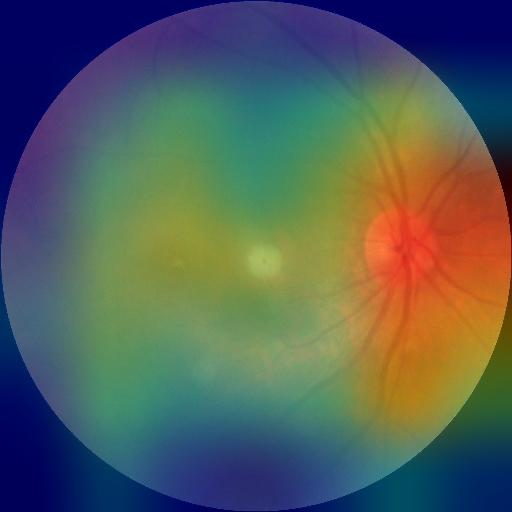

In [ ]:
import tensorflow as tf
import numpy as np
import keras
import matplotlib.pyplot as plt
from keras.preprocessing import image
from keras.applications.resnet50 import ResNet50, preprocess_input, decode_predictions
from IPython.display import Image, display


def save_and_display_gradcam(img_path, heatmap, cam_path="image.jpg", alpha=0.4):
    img = keras.preprocessing.image.load_img(img_path)
    img = keras.preprocessing.image.img_to_array(img)
    heatmap = np.uint8(255 * heatmap)

    jet = plt.cm.jet

    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.preprocessing.image.img_to_array(jet_heatmap)
    Superimposed_img = jet_heatmap * alpha + img
    Superimposed_img = keras.preprocessing.image.array_to_img(Superimposed_img)
    Superimposed_img.save(cam_path)

    display(Image(cam_path))


img_path = "/content/drive/MyDrive/MiniProject2/Dataset/preprocessed_images/0_right.jpg"

img_array = preprocess_input(get_img_array(img_path, size=img_size))


model = ResNet50(weights='imagenet')

model.layers[-1].activation = None

last_conv_layer_name = "conv5_block3_out"
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

save_and_display_gradcam(img_path, heatmap)


Inception

96112376/96112376 [==============================] - 5s 0us/step


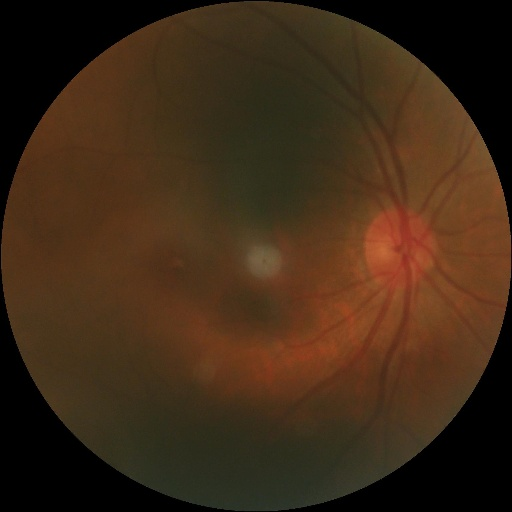

In [ ]:
import tensorflow as tf
import numpy as np
import keras
from keras.preprocessing import image
from keras.applications.inception_v3 import InceptionV3, preprocess_input, decode_predictions
from IPython.display import Image, display

model = InceptionV3(weights='imagenet')

last_conv_layer_name = "mixed10"

img_path = "/content/drive/MyDrive/MiniProject2/Dataset/preprocessed_images/0_right.jpg"
display(Image(img_path))

def get_img_array(img_path, size):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return preprocess_input(array)

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, last_conv_layer_output)

    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()


img_size = (299, 299)
img_array = get_img_array(img_path, img_size)


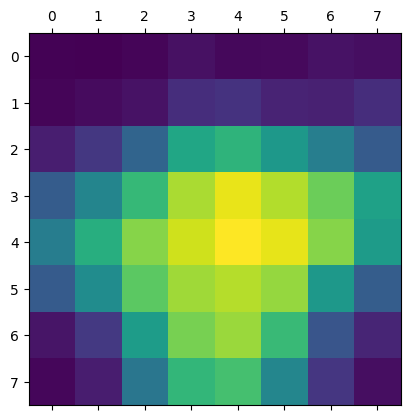

In [ ]:
import tensorflow as tf
import numpy as np
import keras
import matplotlib.pyplot as plt
from keras.preprocessing import image
from keras.applications.inception_v3 import InceptionV3, preprocess_input, decode_predictions


img_path = "/content/drive/MyDrive/MiniProject2/Dataset/preprocessed_images/0_right.jpg"


img_array = preprocess_input(get_img_array(img_path, size=img_size))


model = InceptionV3(weights='imagenet')


model.layers[-1].activation = None


last_conv_layer_name = "mixed10"
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)


plt.matshow(heatmap)
plt.show()


<ipython-input-9-b9194a59a1f3>:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = mpl.cm.get_cmap("jet")


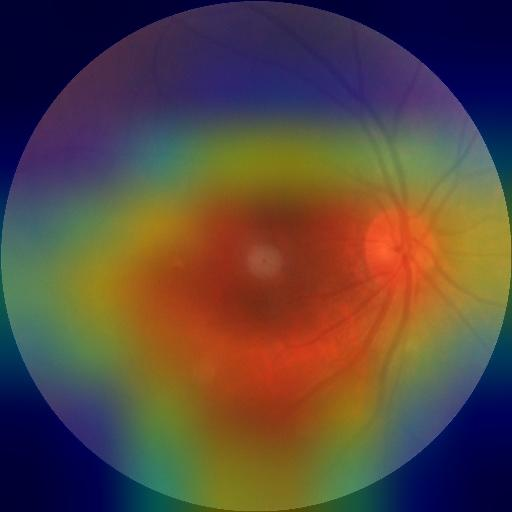

In [ ]:
import numpy as np
import keras
import matplotlib.pyplot as plt
import matplotlib as mpl
from keras.preprocessing import image
from keras.applications.inception_v3 import InceptionV3, preprocess_input

def save_and_display_gradcam(img_path, heatmap, cam_path="image.jpg", alpha=0.4):
    """Saves and displays the GradCAM heatmap."""
    img = keras.utils.load_img(img_path)
    img = keras.utils.img_to_array(img)
    heatmap = np.uint8(255 * heatmap)

    jet = mpl.cm.get_cmap("jet")

    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)
    Superimposed_img = jet_heatmap * alpha + img
    Superimposed_img = keras.utils.array_to_img(Superimposed_img)
    Superimposed_img.save(cam_path)

    display(Image(cam_path))


img_path = "/content/drive/MyDrive/MiniProject2/Dataset/preprocessed_images/0_right.jpg"


img_array = preprocess_input(get_img_array(img_path, size=img_size))


model = InceptionV3(weights='imagenet')


model.layers[-1].activation = None


last_conv_layer_name = "mixed10"


heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)


save_and_display_gradcam(img_path, heatmap)


Multiple Images-Inception
# Multiple images - Inception


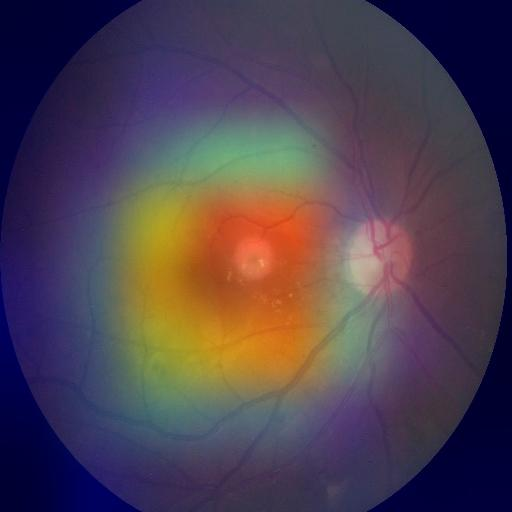

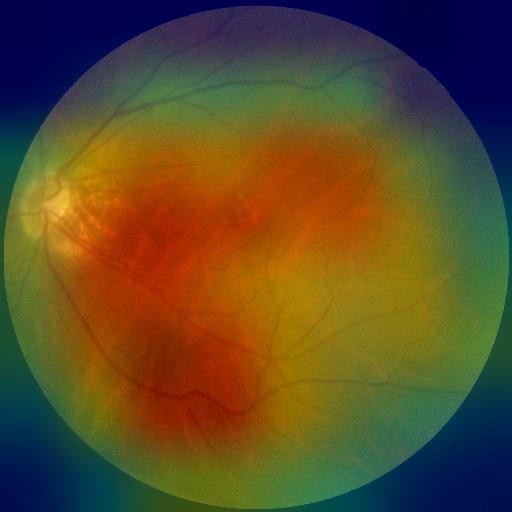

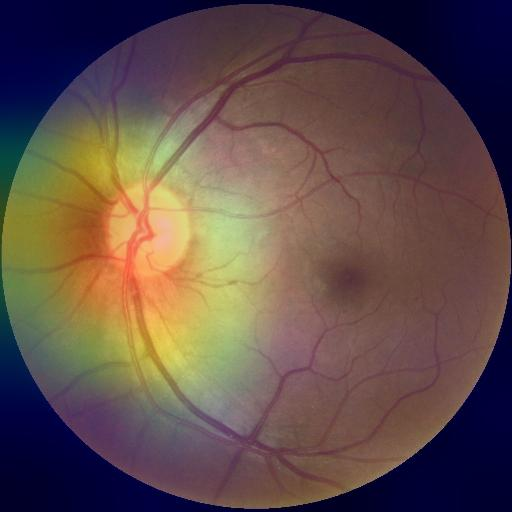

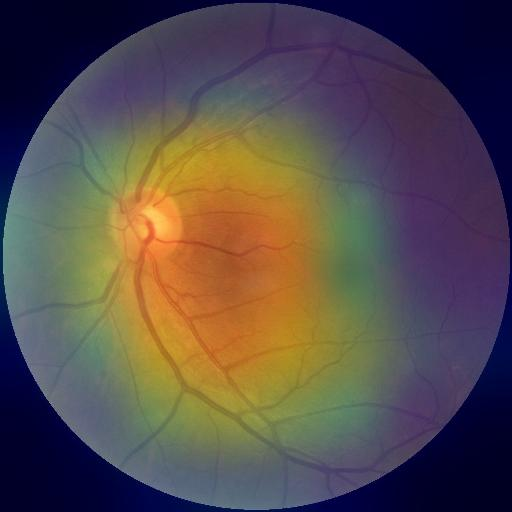

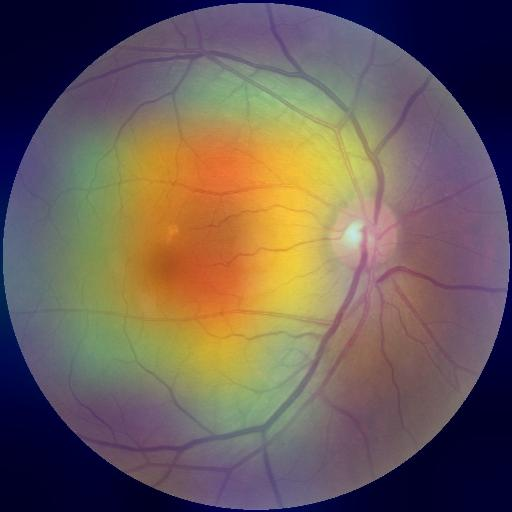

...

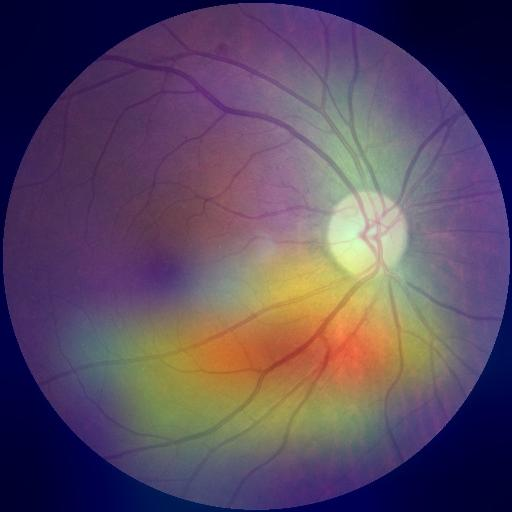

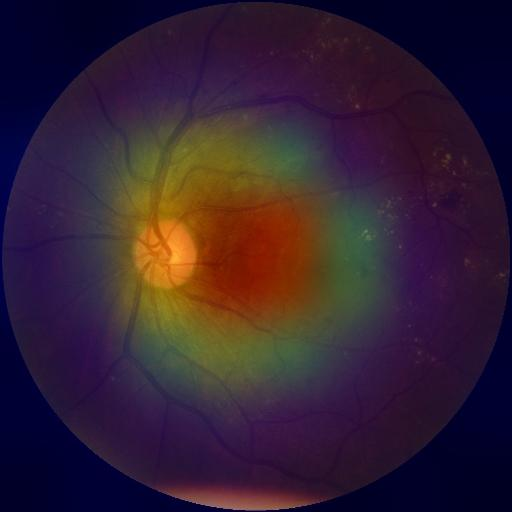

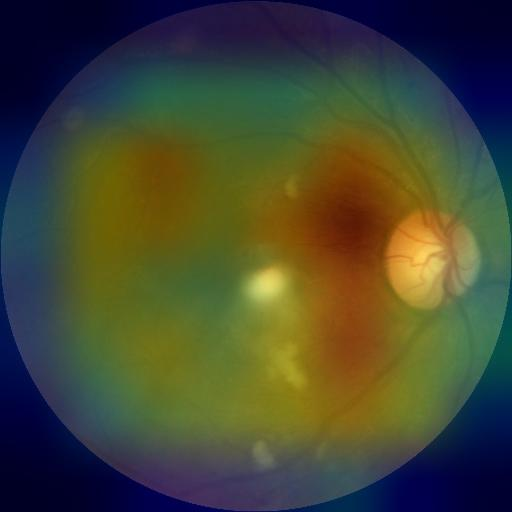

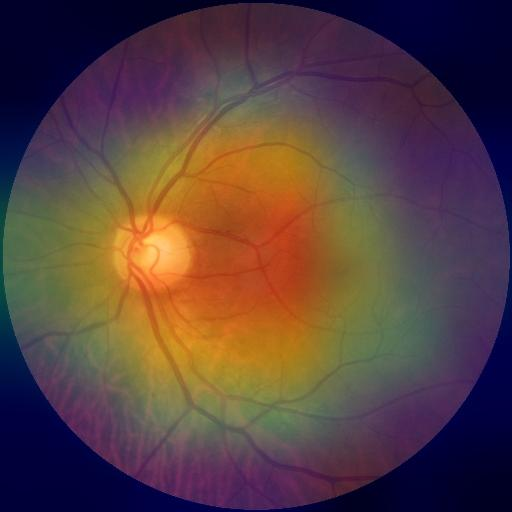

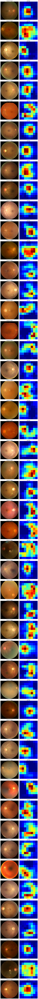

In [ ]:
import numpy as np
import tensorflow as tf
import os
from keras.preprocessing import image
from keras.applications.inception_v3 import InceptionV3, preprocess_input
import matplotlib.pyplot as plt
import matplotlib as mpl
from IPython.display import Image

# Initialize the InceptionV3 model
model = InceptionV3(weights='imagenet')

# Specify the name of the last convolutional layer
last_conv_layer_name = "mixed10"

def get_img_array(img_path, size):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return preprocess_input(array)

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]
    grads = tape.gradient(class_channel, last_conv_layer_output)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

def save_and_display_gradcam(img_path, heatmap, cam_path):
    img = tf.keras.utils.load_img(img_path)
    img = tf.keras.utils.img_to_array(img)
    heatmap = np.uint8(255 * heatmap)
    jet = mpl.colormaps["jet"]
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]
    jet_heatmap = tf.keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = tf.keras.utils.img_to_array(jet_heatmap)
    superimposed_img = jet_heatmap * 0.4 + img
    superimposed_img = tf.keras.utils.array_to_img(superimposed_img)
    superimposed_img.save(cam_path)
    display(Image(filename=cam_path))

def generate_gradcam_for_images(image_paths, model, last_conv_layer_name, target_size, heatmap_dir):
    fig, axes = plt.subplots(len(image_paths), 2, figsize=(8, len(image_paths) * 4))
    for i, img_path in enumerate(image_paths):
        # Load the image and convert it into an array
        img_array = get_img_array(img_path, target_size)

        # Generate Grad-CAM heatmap
        heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

        # Display the original image on the left column
        axes[i][0].imshow(image.load_img(img_path, target_size=(256, 256)))
        axes[i][0].set_title("Original Image", fontsize=12)
        axes[i][0].axis("off")

        # Display the jet map on the right column
        axes[i][1].imshow(heatmap, cmap="jet")
        axes[i][1].set_title("Jet Map", fontsize=12)
        axes[i][1].axis("off")

        # Save and display GradCAM heatmap
        img_name = os.path.basename(img_path)
        cam_path = os.path.join(heatmap_dir, img_name)
        save_and_display_gradcam(img_path, heatmap, cam_path)

    plt.tight_layout()
    plt.show()

# Define the path to the directory containing multiple image files
images_dir_path = "/content/drive/MyDrive/MiniProject2/Gradcam"
heatmap_dir = "/content/drive/MyDrive/MiniProject2/Heatmap_inception"

# Read image paths from the directory
image_paths = []
for filename in os.listdir(images_dir_path):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        image_paths.append(os.path.join(images_dir_path, filename))

# Define the target size for the images (InceptionV3 input size)
target_size = (299, 299)

# Generate Grad-CAM heatmaps for the images
generate_gradcam_for_images(image_paths, model, last_conv_layer_name, target_size, heatmap_dir)

Classified-14  Unclassifed-22

# MULTIPLE IMAGES-RESNET

<ipython-input-7-c6cc4b4444c8>:41: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = mpl.cm.get_cmap("jet")


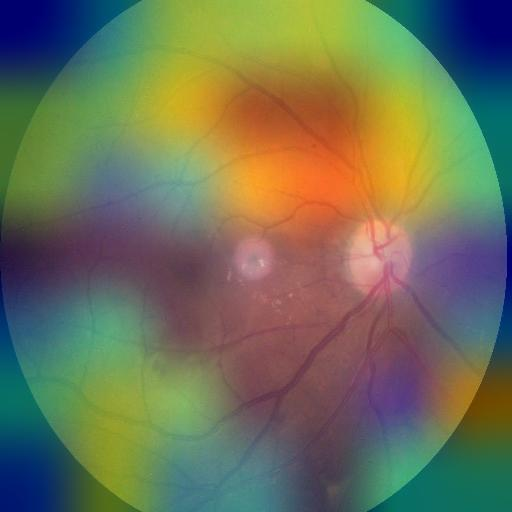

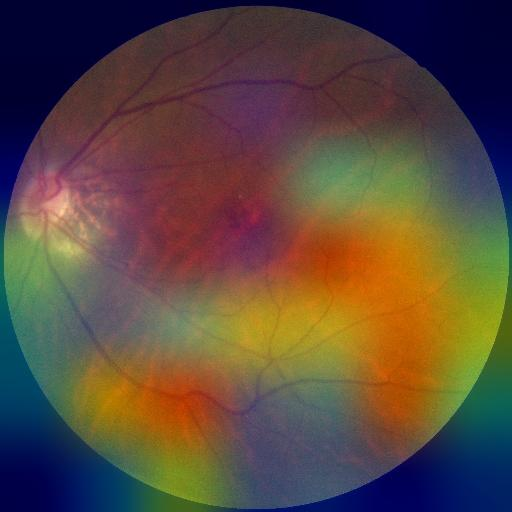

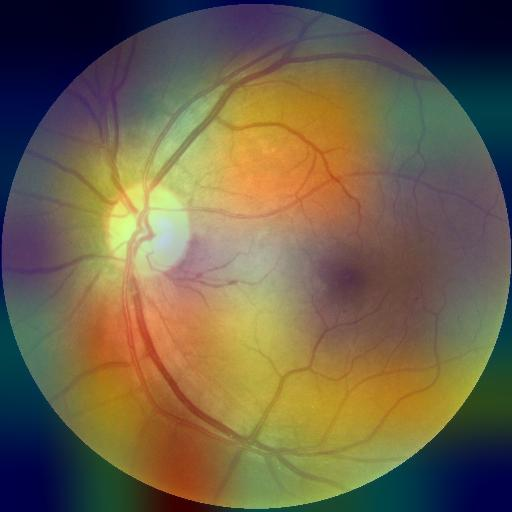

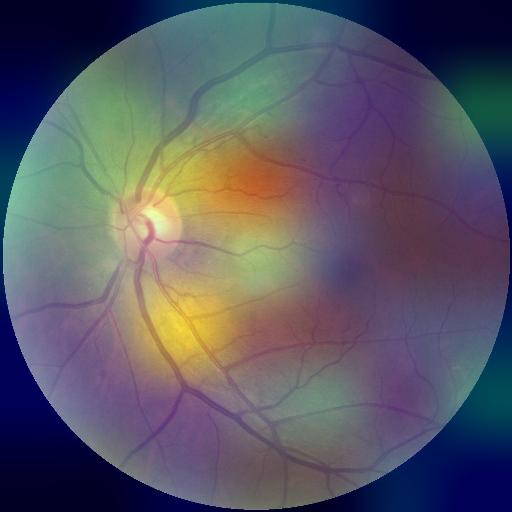

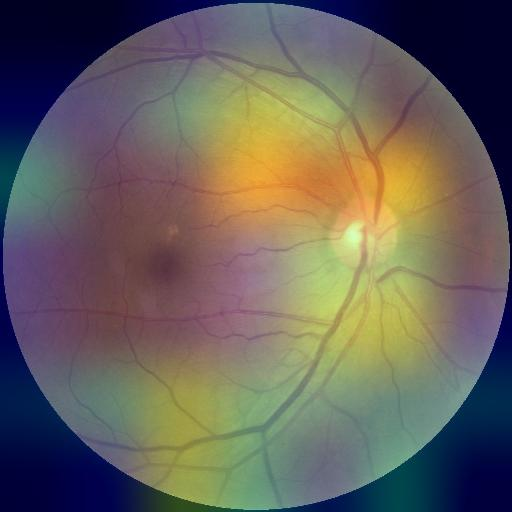

...

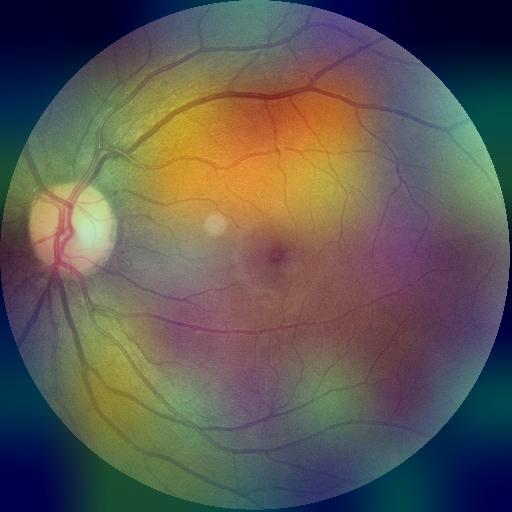

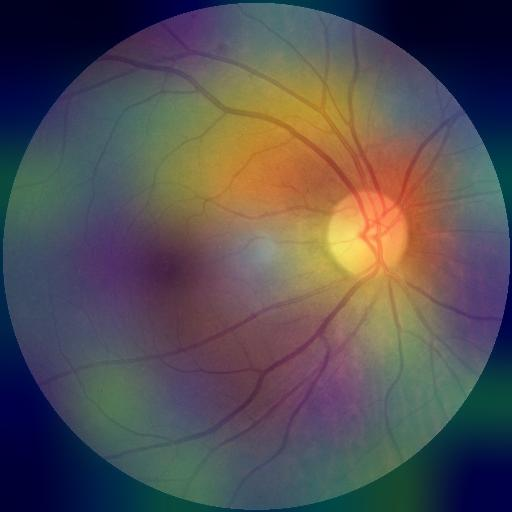

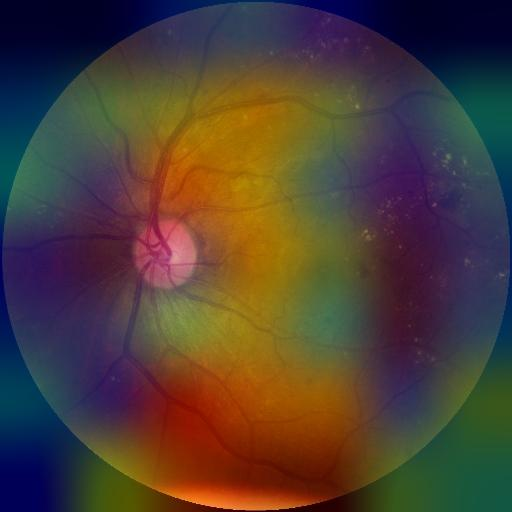

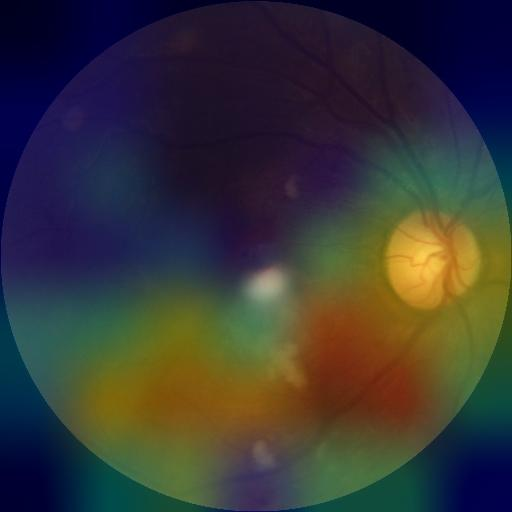

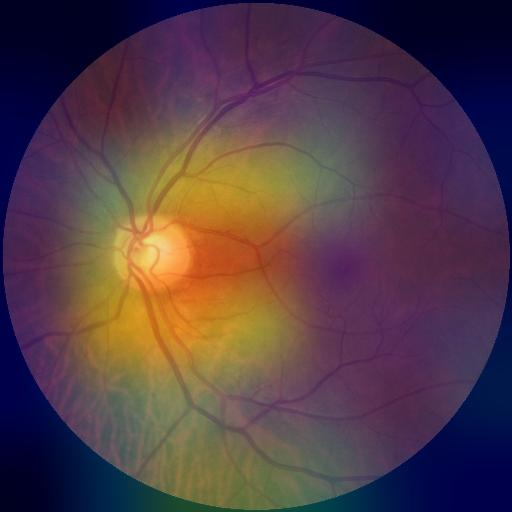

In [ ]:
import tensorflow as tf
import numpy as np
import keras
from keras.preprocessing import image
from keras.applications.resnet50 import ResNet50, preprocess_input, decode_predictions
from IPython.display import display, Image
import os
import matplotlib.pyplot as plt
import matplotlib as mpl

model = ResNet50(weights='imagenet')
last_conv_layer_name = "conv5_block3_out"

def get_img_array(img_path, size):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return preprocess_input(array)

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]
    grads = tape.gradient(class_channel, last_conv_layer_output)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

def save_and_display_gradcam(img_path, heatmap, cam_path):
    img = keras.utils.load_img(img_path)
    img = keras.utils.img_to_array(img)
    heatmap = np.uint8(255 * heatmap)
    jet = mpl.cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]
    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)
    superimposed_img = jet_heatmap * 0.4 + img
    superimposed_img = keras.utils.array_to_img(superimposed_img)
    superimposed_img.save(cam_path)
    display(Image(cam_path))

images_dir = "/content/drive/MyDrive/MiniProject2/Gradcam"
heatmap_dir = "/content/drive/MyDrive/MiniProject2/heatmap_resnet"

def process_images(images_dir, heatmap_dir, model, last_conv_layer_name, size):
    image_paths = [os.path.join(images_dir, img_name) for img_name in os.listdir(images_dir)]
    for img_path in image_paths:
        img_array = get_img_array(img_path, size)
        heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)
        img_name = os.path.basename(img_path)
        cam_path = os.path.join(heatmap_dir, img_name)
        save_and_display_gradcam(img_path, heatmap, cam_path)

img_size = (224, 224)
process_images(images_dir, heatmap_dir, model, last_conv_layer_name, img_size)

# Smoothening -Resnet

In [ ]:
import os
import cv2

def smooth_images_in_folder(input_folder, output_folder, kernel_size=(5, 5)):

    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    image_files = [f for f in os.listdir(input_folder) if os.path.isfile(os.path.join(input_folder, f))]

    for image_file in image_files:

        image_path = os.path.join(input_folder, image_file)
        image = cv2.imread(image_path)

        smoothed_image = cv2.GaussianBlur(image, kernel_size, 0)

        output_path = os.path.join(output_folder, image_file)  # Construct output path
        cv2.imwrite(output_path, smoothed_image)

    print("Smoothing complete.")

input_folder = '/content/drive/MyDrive/MiniProject2/New_smooth'
output_folder = '/content/drive/MyDrive/MiniProject2/Grad_smooth'
smooth_images_in_folder(input_folder, output_folder)


Smoothing complete.


# New processing

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/MiniProject2/Dataset/full_df.csv")
df.head()

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg
2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",2_right.jpg
3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4_right.jpg
4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",5_right.jpg


In [ ]:
classes = { 0: "Normal",
            1: "Diabetes",
            2: "Glaucoma",
            3: "Cataract",
            4: "Age related Macular Degeneration",
            5: "Hypertension",
            6: "Pathological Myopia",
            7: "Other diseases/abnormalities"
          }

In [ ]:
import json

In [ ]:
df.head()

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg
2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",2_right.jpg
3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4_right.jpg
4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",5_right.jpg


In [ ]:
targets = np.array(df["target"].apply(lambda x: json.loads(x)).tolist())
targets.shape

(6392, 8)

In [ ]:
df["class_name"] = np.argmax(targets, axis=1).tolist()
df["class_name"] = df["class_name"] .replace(classes)
df.head()

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename,class_name
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg,Normal
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg,Normal
2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",2_right.jpg,Diabetes
3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4_right.jpg,Diabetes
4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",5_right.jpg,Diabetes


In [ ]:
data_cleaned = df[["ID",  "filename", "class_name", "target"]]
data_cleaned.to_csv("/content/drive/MyDrive/MiniProject2/data_cleaned.csv", index=False)

In [ ]:
data_cleaned.head()

,ID,filename,class_name,target
0,0,0_right.jpg,Normal,"[1, 0, 0, 0, 0, 0, 0, 0]"
1,1,1_right.jpg,Normal,"[1, 0, 0, 0, 0, 0, 0, 0]"
2,2,2_right.jpg,Diabetes,"[0, 1, 0, 0, 0, 0, 0, 0]"
3,4,4_right.jpg,Diabetes,"[0, 1, 0, 0, 0, 0, 0, 0]"
4,5,5_right.jpg,Diabetes,"[0, 1, 0, 0, 0, 0, 0, 0]"


In [ ]:
import os
fullname = []
processed = "/content/drive/MyDrive/MiniProject2/Gradcamm"
for i in data_cleaned['filename']:
  fullname.append(os.path.join(processed, i))

In [ ]:
len(fullname)

6392

In [ ]:
data_cleaned['fullname'] = fullname

<ipython-input-34-0a2d6cb9e081>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_cleaned['fullname'] = fullname


In [ ]:
data_cleaned['class_name'].value_counts()

class_name
Normal                              2873
Diabetes                            1608
Other diseases/abnormalities         708
Cataract                             293
Glaucoma                             284
Age related Macular Degeneration     266
Pathological Myopia                  232
Hypertension                         128
Name: count, dtype: int64

In [ ]:
images = []
classes = []
y = data_cleaned['class_name']
class_count = {
"Normal"                           :   0,
"Diabetes"                           : 0,
"Other diseases/abnormalities"        : 0,
"Cataract"                            : 0,
"Glaucoma"                            : 0,
"Age related Macular Degeneration"    : 0,
"Pathological Myopia"                 : 0,
"Hypertension"                        : 0
}
for i in range(len(y)):
  if class_count[y[i]] <= 127:
    images.append(data_cleaned['filename'][i])
    classes.append(data_cleaned['class_name'][i])
    class_count[y[i]]+=1
print(class_count)


{'Normal': 128, 'Diabetes': 128, 'Other diseases/abnormalities': 128, 'Cataract': 128, 'Glaucoma': 128, 'Age related Macular Degeneration': 128, 'Pathological Myopia': 128, 'Hypertension': 128}


In [ ]:
downsample_data = pd.DataFrame()
downsample_data['fullname'] = images
downsample_data['class'] = classes
downsample_data.head()

,fullname,class
0,0_right.jpg,Normal
1,1_right.jpg,Normal
2,2_right.jpg,Diabetes
3,4_right.jpg,Diabetes
4,5_right.jpg,Diabetes


In [ ]:
downsample_data.to_csv("/content/drive/MyDrive/MiniProject2/downsample.csv", index=False)

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
train_datagen = ImageDataGenerator(rescale=1./255)
X_train, X_test, y_train, y_test = train_test_split(downsample_data['fullname'], downsample_data['class'], test_size=0.2, random_state=42)
data_train = pd.DataFrame()
data_train['images'] = X_train
data_train['labels'] = y_train
data_test = pd.DataFrame()
data_test['images'] = X_test
data_test['labels'] = y_test
data_test.to_csv("/content/drive/MyDrive/MiniProject2/downtest.csv", index=False)
train_dir ="/content/drive/MyDrive/MiniProject2/Gradcamm"
train_generator = train_datagen.flow_from_dataframe(downsample_data, directory = train_dir, x_col ="fullname", y_col="class", class_mode="categorical", shuffle=True, target_size=(224, 224))
valid_generator = train_datagen.flow_from_dataframe(data_test, directory = train_dir, x_col ="images", y_col="labels", class_mode="categorical", shuffle=False, target_size=(224, 224))

Found 0 validated image filenames belonging to 0 classes.
Found 0 validated image filenames belonging to 0 classes.


/usr/local/lib/python3.10/dist-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 1024 invalid image filename(s) in x_col="fullname". These filename(s) will be ignored.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 205 invalid image filename(s) in x_col="images". These filename(s) will be ignored.
  warnings.warn(


In [ ]:
valid_generator = train_datagen.flow_from_dataframe(data_test, directory = train_dir, x_col ="images", y_col="labels", class_mode="categorical", shuffle=False, target_size=(224, 224))

Found 0 validated image filenames belonging to 0 classes.


/usr/local/lib/python3.10/dist-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 205 invalid image filename(s) in x_col="images". These filename(s) will be ignored.
  warnings.warn(


<ipython-input-40-85ccc82f5a52>:48: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = mpl.cm.get_cmap("jet")


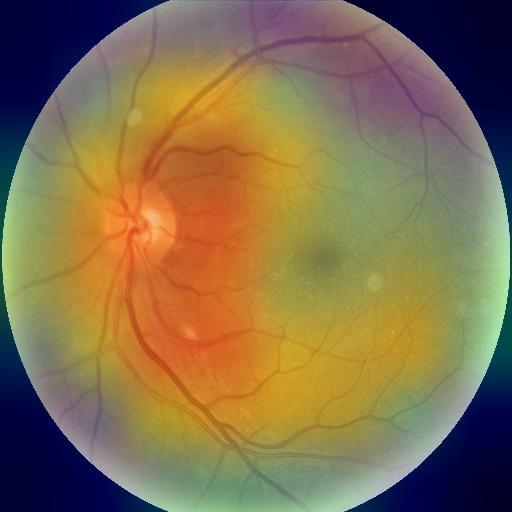

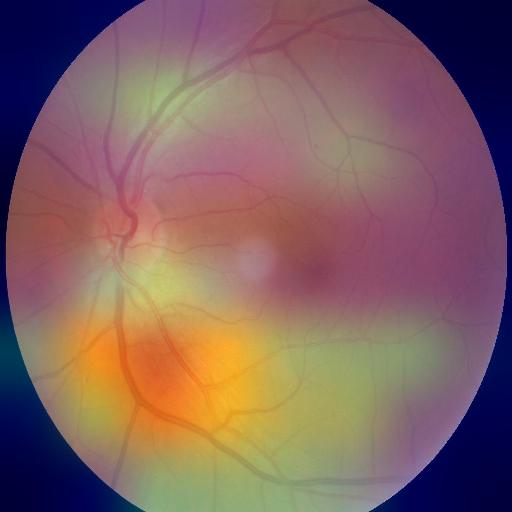

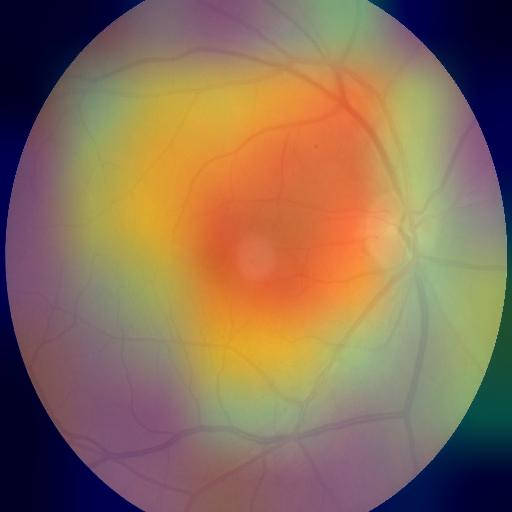

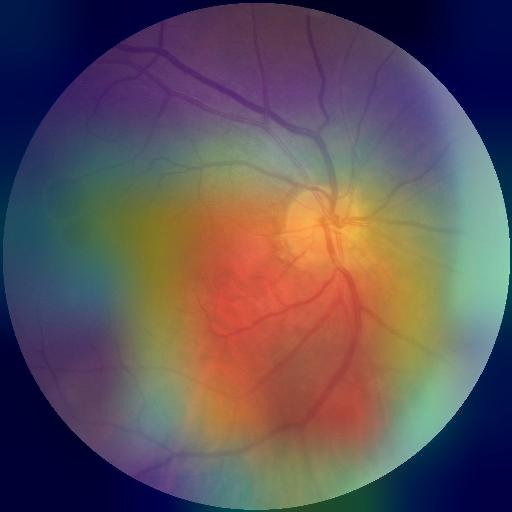

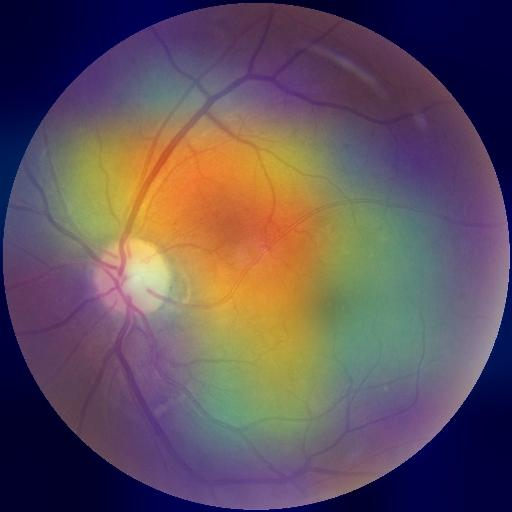

...

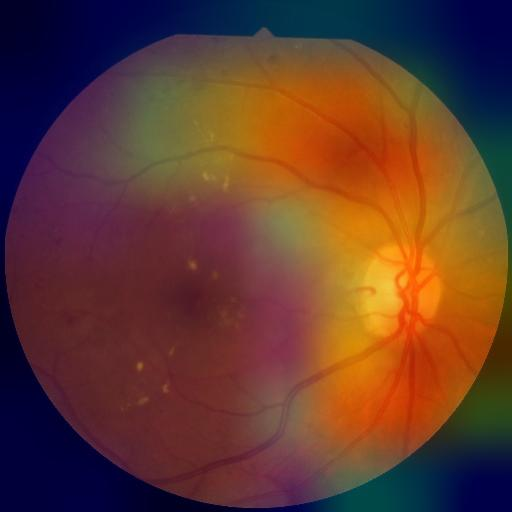

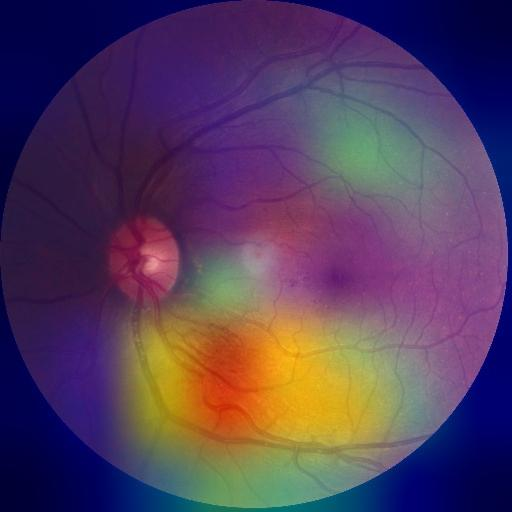

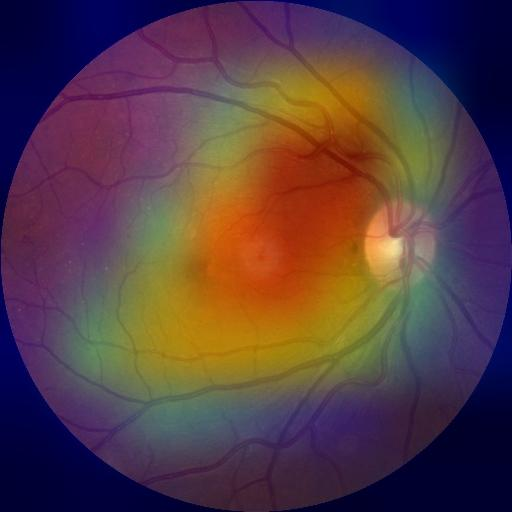

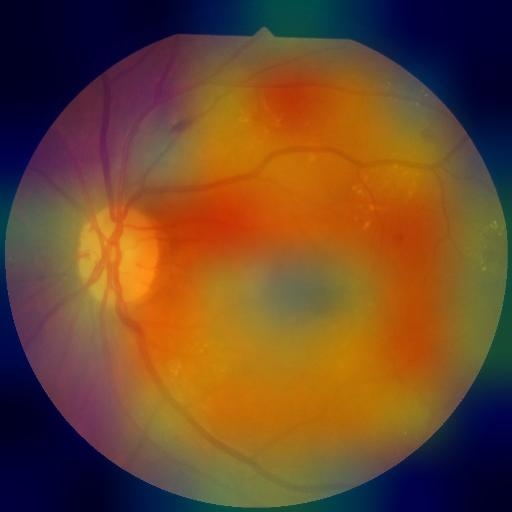

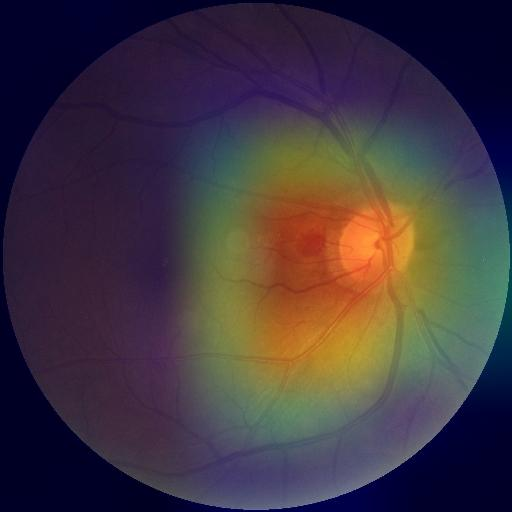

In [ ]:
import tensorflow as tf
import numpy as np
import keras
from keras.preprocessing import image
from keras.applications.inception_v3 import InceptionV3, preprocess_input, decode_predictions
from IPython.display import display, Image
import os
import matplotlib.pyplot as plt
import matplotlib as mpl

model = InceptionV3(weights='imagenet')

last_conv_layer_name = "mixed10"

def get_img_array(img_path, size):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return preprocess_input(array)

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, last_conv_layer_output)

    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()


def save_and_display_gradcam(img_path, heatmap, cam_path="image.jpg", alpha=0.4):
    img = keras.utils.load_img(img_path)
    img = keras.utils.img_to_array(img)
    heatmap = np.uint8(255 * heatmap)

    jet = mpl.cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = keras.utils.array_to_img(superimposed_img)
    superimposed_img.save(cam_path)

    display(Image(cam_path))

images_dir = "/content/drive/MyDrive/MiniProject2/Gradcamm"

def process_images(images_dir, model, last_conv_layer_name, size):
    image_paths = [os.path.join(images_dir, img_name) for img_name in os.listdir(images_dir)]

    for img_path in image_paths:

        img_array = get_img_array(img_path, size)


        heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)
        save_and_display_gradcam(img_path, heatmap)

img_size = (299, 299)

process_images(images_dir, model, last_conv_layer_name, img_size)


<ipython-input-41-16aef46861ab>:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = mpl.cm.get_cmap("jet")


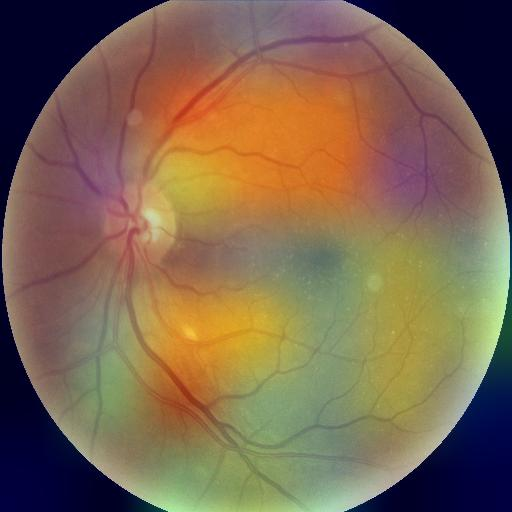

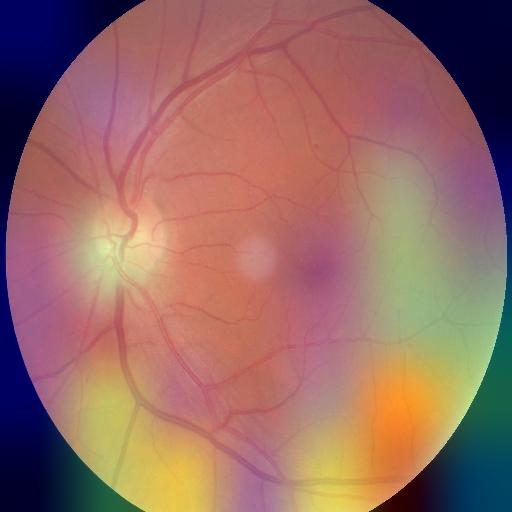

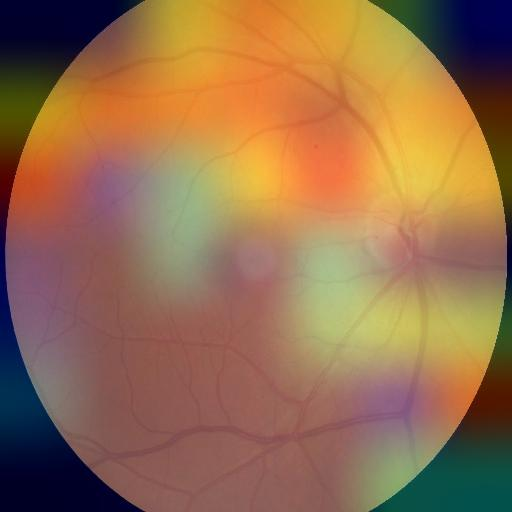

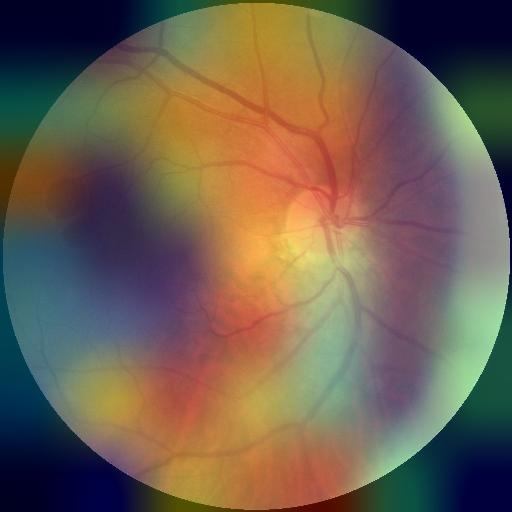

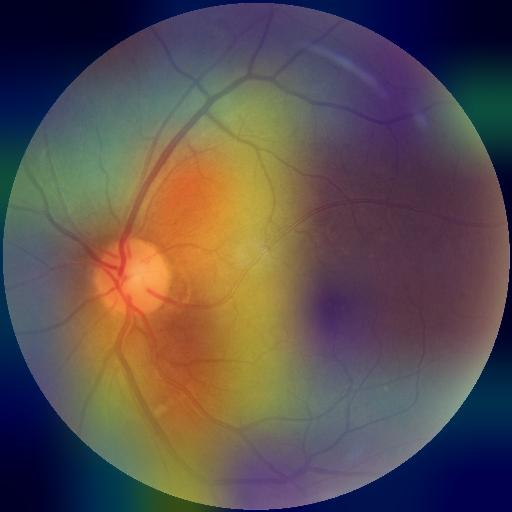

...

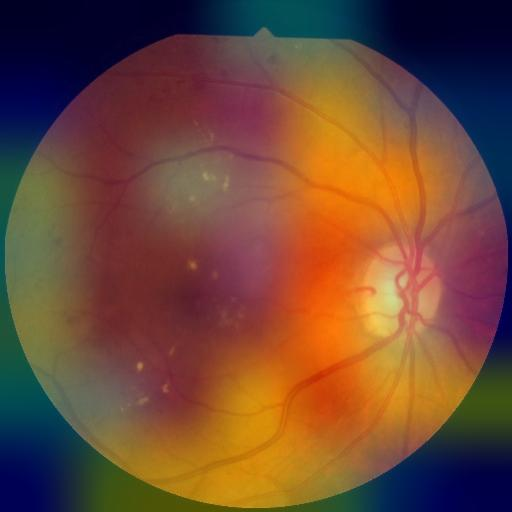

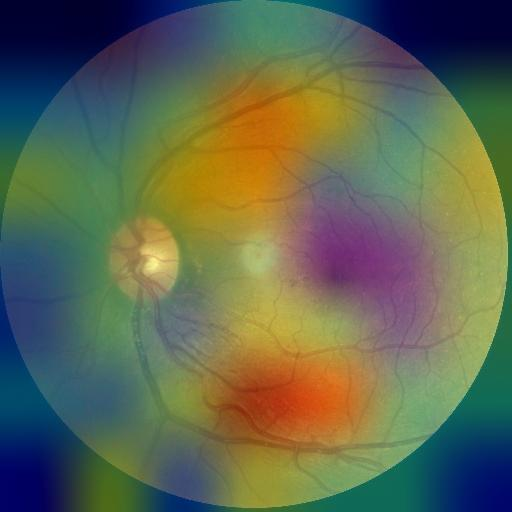

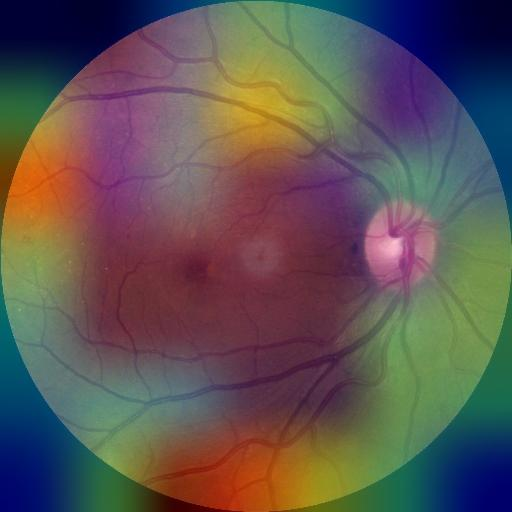

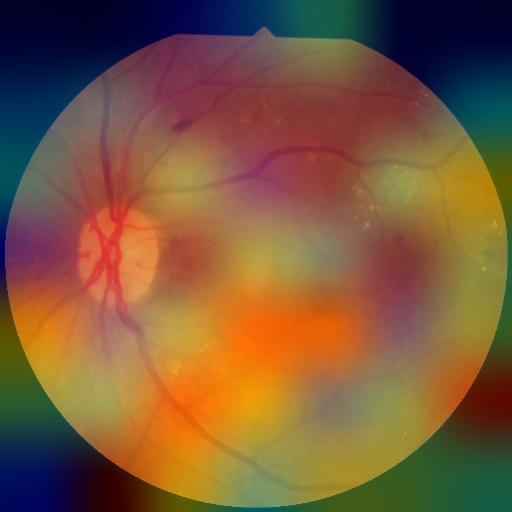

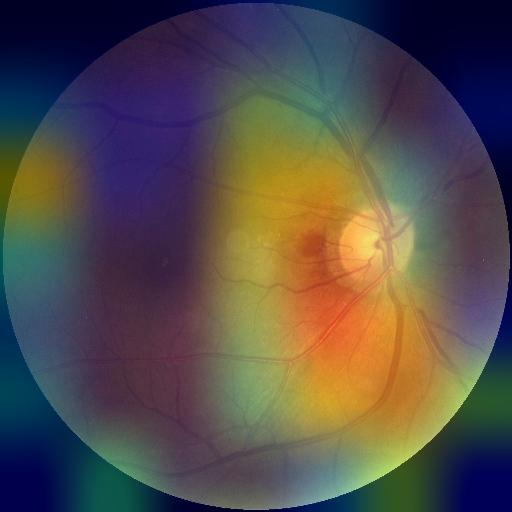

In [ ]:
import tensorflow as tf
import numpy as np
import keras
from keras.preprocessing import image
from keras.applications.resnet50 import ResNet50, preprocess_input, decode_predictions
from IPython.display import display, Image
import os
import matplotlib.pyplot as plt
import matplotlib as mpl


model = ResNet50(weights='imagenet')


last_conv_layer_name = "conv5_block3_out"

def get_img_array(img_path, size):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return preprocess_input(array)

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, last_conv_layer_output)

    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()


def save_and_display_gradcam(img_path, heatmap, cam_path="image.jpg", alpha=0.4):
    img = keras.utils.load_img(img_path)
    img = keras.utils.img_to_array(img)
    heatmap = np.uint8(255 * heatmap)

    jet = mpl.cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = keras.utils.array_to_img(superimposed_img)
    superimposed_img.save(cam_path)

    display(Image(cam_path))


images_dir = "/content/drive/MyDrive/MiniProject2/Gradcamm"

def process_images(images_dir, model, last_conv_layer_name, size):
    image_paths = [os.path.join(images_dir, img_name) for img_name in os.listdir(images_dir)]

    for img_path in image_paths:

        img_array = get_img_array(img_path, size)


        heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)


        save_and_display_gradcam(img_path, heatmap)

img_size = (224, 224)


process_images(images_dir, model, last_conv_layer_name, img_size)


# Smoothening

In [ ]:
import os
import cv2

def smooth_images_in_folder(input_folder, output_folder, kernel_size=(5, 5)):

    if not os.path.exists(output_folder):
        os.makedirs(output_folder)


    image_files = [f for f in os.listdir(input_folder) if os.path.isfile(os.path.join(input_folder, f))]

    for image_file in image_files:

        image_path = os.path.join(input_folder, image_file)
        image = cv2.imread(image_path)

        smoothed_image = cv2.GaussianBlur(image, kernel_size, 0)

        output_path = os.path.join(output_folder, image_file)
        cv2.imwrite(output_path, smoothed_image)

    print("Smoothing complete.")

input_folder = '/content/drive/MyDrive/MiniProject2/Gradcam'
output_folder = '/content/drive/MyDrive/MiniProject2/Grad_smooth'
smooth_images_in_folder(input_folder, output_folder)

Smoothing complete.


In [ ]:

from google.colab import drive
drive.mount('/content/drive')

import os
import cv2
import numpy as np

def sharpen_images_in_folder(input_folder, output_folder):

    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    image_files = [f for f in os.listdir(input_folder) if os.path.isfile(os.path.join(input_folder, f))]

    for image_file in image_files:

        image_path = os.path.join(input_folder, image_file)
        image = cv2.imread(image_path)


        kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
        sharpened_image = cv2.filter2D(image, -1, kernel)

        output_path = os.path.join(output_folder, image_file)
        cv2.imwrite(output_path, sharpened_image)

    print("Sharpening complete.")
input_folder = '/content/drive/MyDrive/MiniProject2/Gradcam'
output_folder = '/content/drive/MyDrive/MiniProject2/Grad_sharp'
sharpen_images_in_folder(input_folder, output_folder)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Sharpening complete.


In [ ]:
import os
import cv2

def reduce_noise_in_folder(input_folder, output_folder, kernel_size=(9, 9)):

    if not os.path.exists(output_folder):
        os.makedirs(output_folder)


    image_files = [f for f in os.listdir(input_folder) if os.path.isfile(os.path.join(input_folder, f))]

    for image_file in image_files:
        image_path = os.path.join(input_folder, image_file)
        image = cv2.imread(image_path)

        smoothed_image = cv2.GaussianBlur(image, kernel_size, 0)

        output_path = os.path.join(output_folder, image_file)
        cv2.imwrite(output_path, smoothed_image)

    print("Noise reduction complete.")


input_folder = '/content/drive/MyDrive/MiniProject2/Gradcam'
output_folder = '/content/drive/MyDrive/MiniProject2/Grad_noise'
reduce_noise_in_folder(input_folder, output_folder)


Noise reduction complete.


<ipython-input-10-f62cd0672e0f>:48: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = mpl.cm.get_cmap("jet")


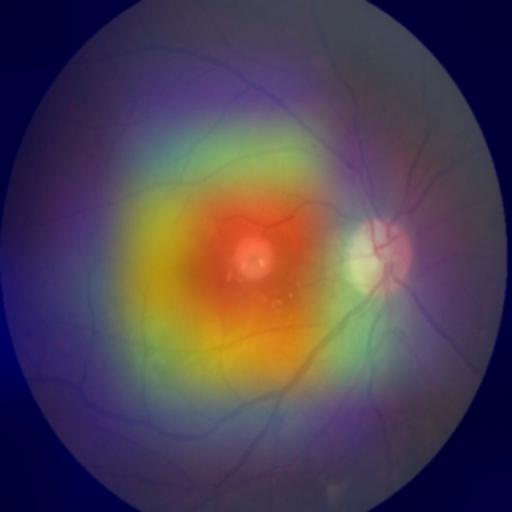

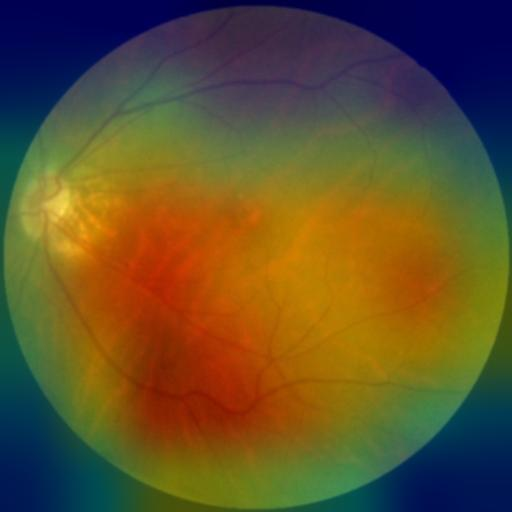

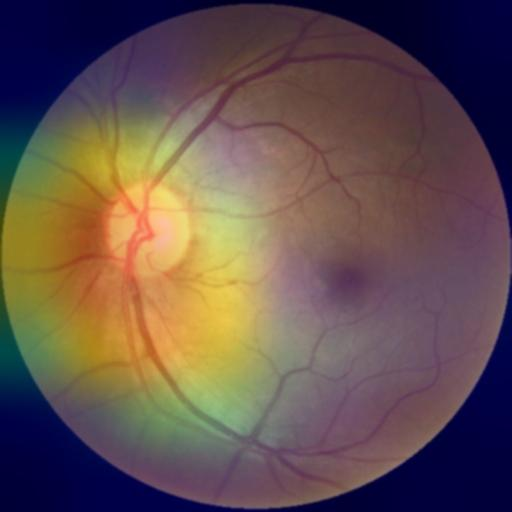

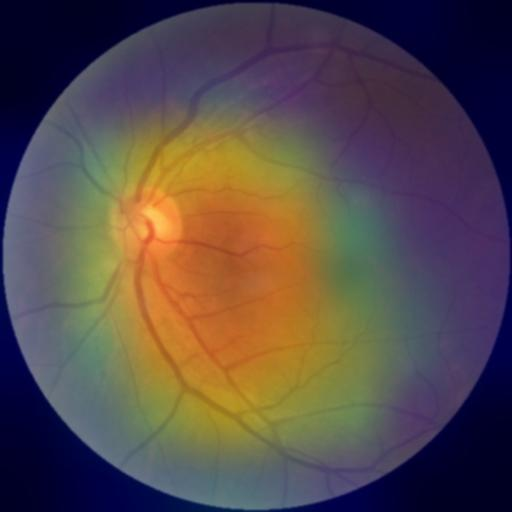

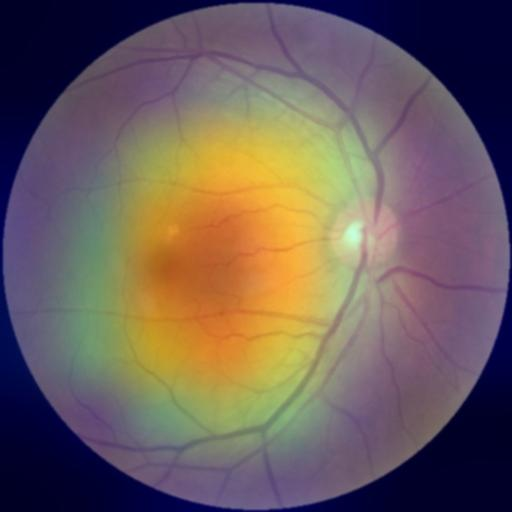

...

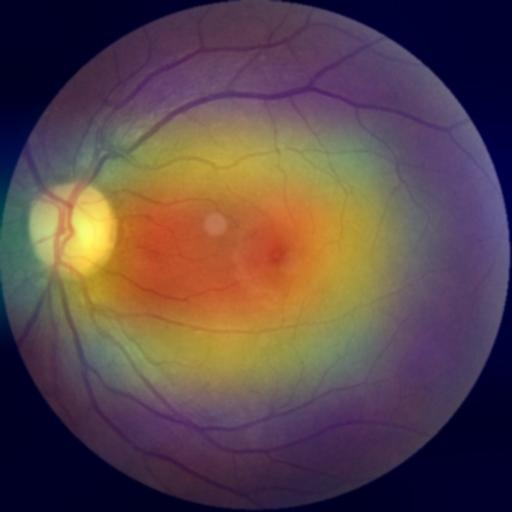

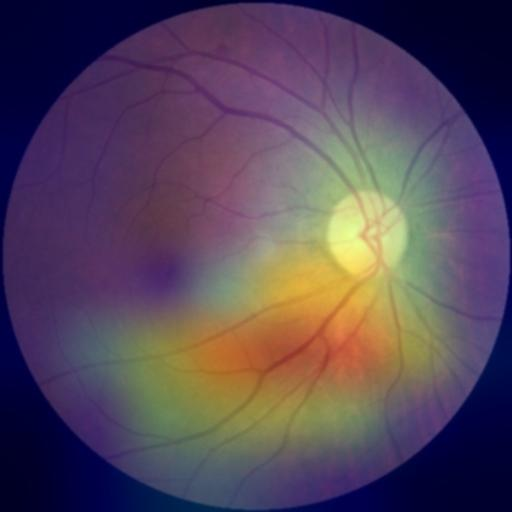

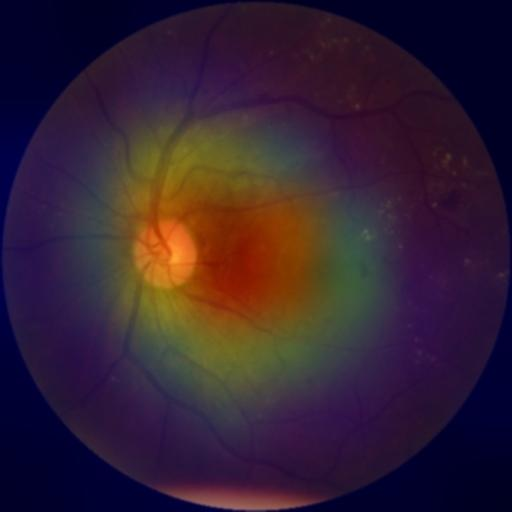

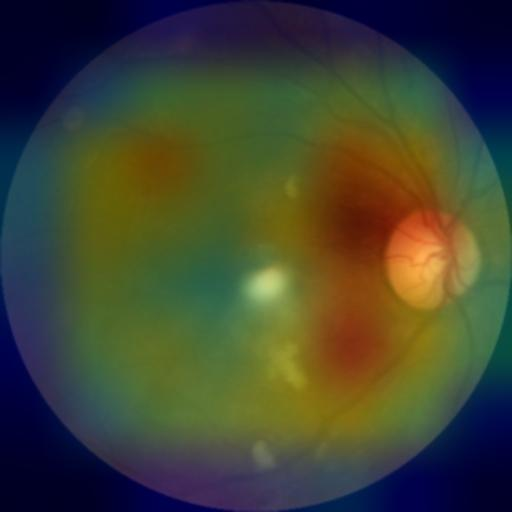

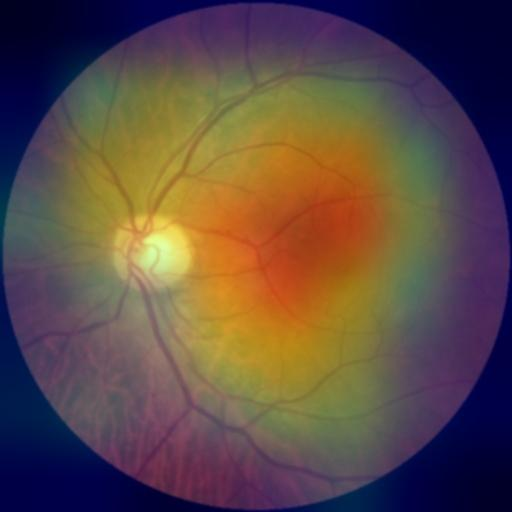

In [ ]:
import tensorflow as tf
import numpy as np
import keras
from keras.preprocessing import image
from keras.applications.inception_v3 import InceptionV3, preprocess_input, decode_predictions
from IPython.display import display, Image
import os
import matplotlib.pyplot as plt
import matplotlib as mpl

model = InceptionV3(weights='imagenet')

last_conv_layer_name = "mixed10"

def get_img_array(img_path, size):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return preprocess_input(array)

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, last_conv_layer_output)

    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()


def save_and_display_gradcam(img_path, heatmap, cam_path="image.jpg", alpha=0.4):
    img = keras.utils.load_img(img_path)
    img = keras.utils.img_to_array(img)
    heatmap = np.uint8(255 * heatmap)

    jet = mpl.cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = keras.utils.array_to_img(superimposed_img)
    superimposed_img.save(cam_path)

    display(Image(cam_path))

images_dir = "/content/drive/MyDrive/MiniProject2/Grad_smooth"

def process_images(images_dir, model, last_conv_layer_name, size):
    image_paths = [os.path.join(images_dir, img_name) for img_name in os.listdir(images_dir)]

    for img_path in image_paths:

        img_array = get_img_array(img_path, size)


        heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)
        save_and_display_gradcam(img_path, heatmap)

img_size = (299, 299)

process_images(images_dir, model, last_conv_layer_name, img_size)


<ipython-input-13-65d0ffb02206>:48: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = mpl.cm.get_cmap("jet")


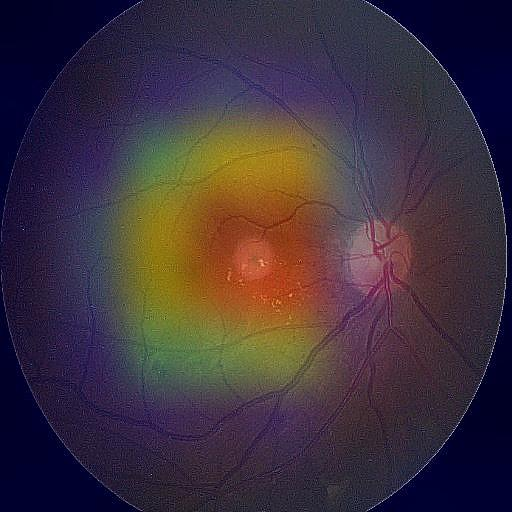

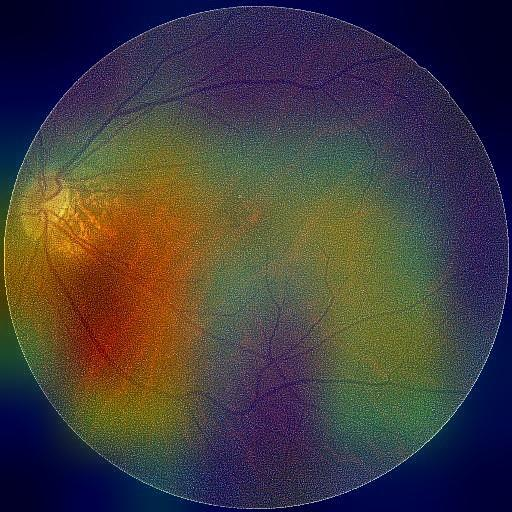

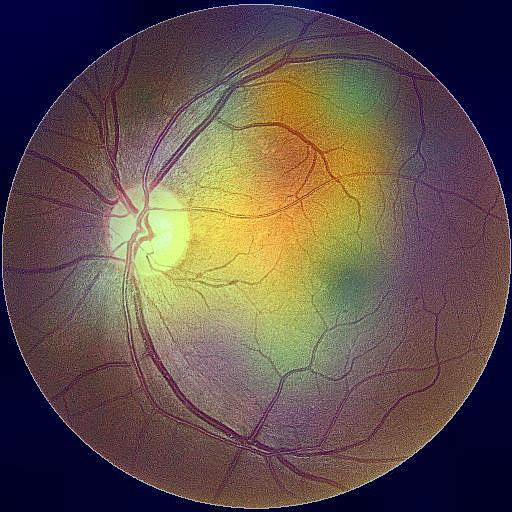

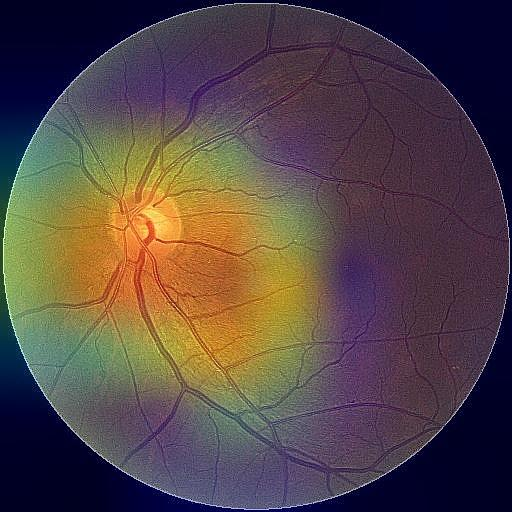

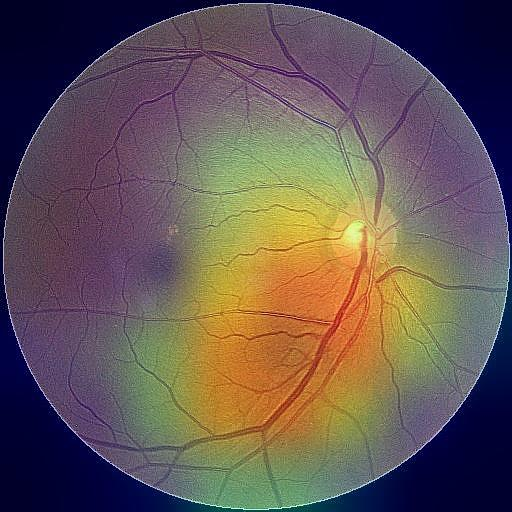

...

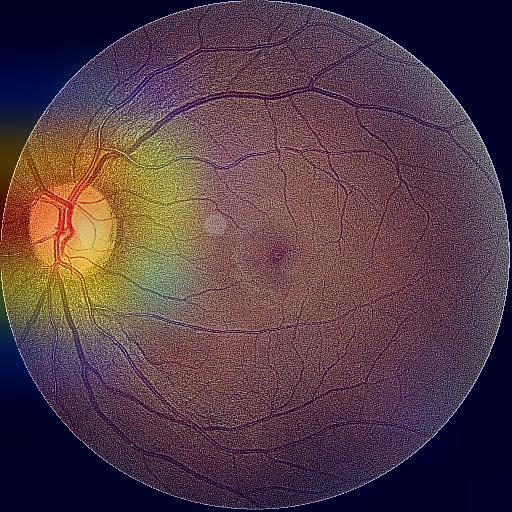

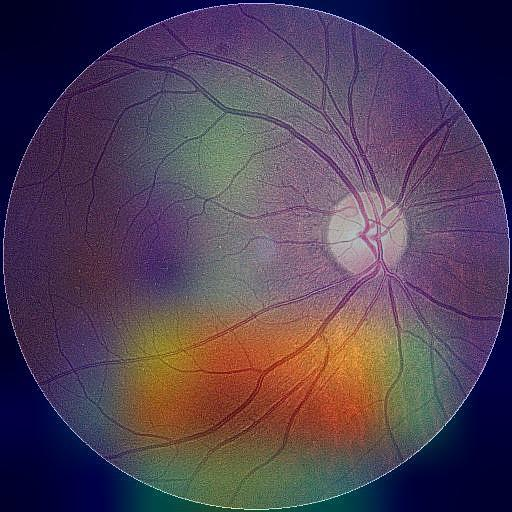

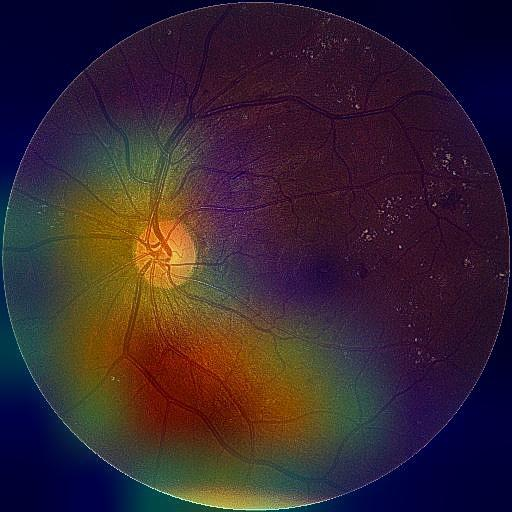

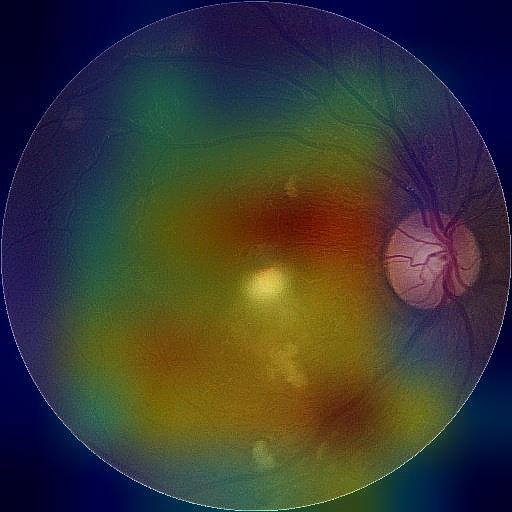

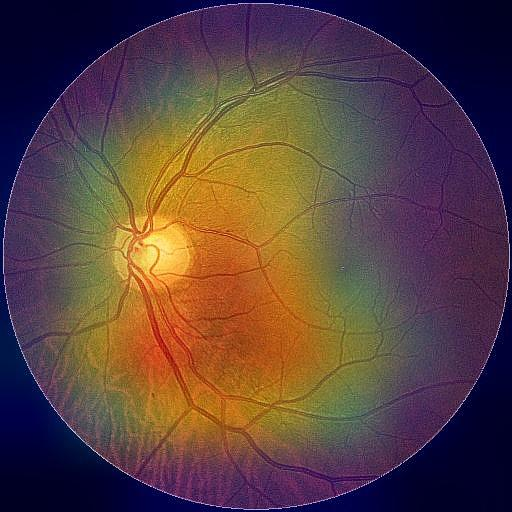

In [ ]:
import tensorflow as tf
import numpy as np
import keras
from keras.preprocessing import image
from keras.applications.inception_v3 import InceptionV3, preprocess_input, decode_predictions
from IPython.display import display, Image
import os
import matplotlib.pyplot as plt
import matplotlib as mpl

model = InceptionV3(weights='imagenet')

last_conv_layer_name = "mixed10"

def get_img_array(img_path, size):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return preprocess_input(array)

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, last_conv_layer_output)

    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()


def save_and_display_gradcam(img_path, heatmap, cam_path="image.jpg", alpha=0.4):
    img = keras.utils.load_img(img_path)
    img = keras.utils.img_to_array(img)
    heatmap = np.uint8(255 * heatmap)

    jet = mpl.cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = keras.utils.array_to_img(superimposed_img)
    superimposed_img.save(cam_path)

    display(Image(cam_path))

images_dir = "/content/drive/MyDrive/MiniProject2/Grad_sharp"

def process_images(images_dir, model, last_conv_layer_name, size):
    image_paths = [os.path.join(images_dir, img_name) for img_name in os.listdir(images_dir)]

    for img_path in image_paths:

        img_array = get_img_array(img_path, size)


        heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)
        save_and_display_gradcam(img_path, heatmap)

img_size = (299, 299)

process_images(images_dir, model, last_conv_layer_name, img_size)


<ipython-input-14-441b63009aed>:48: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = mpl.cm.get_cmap("jet")


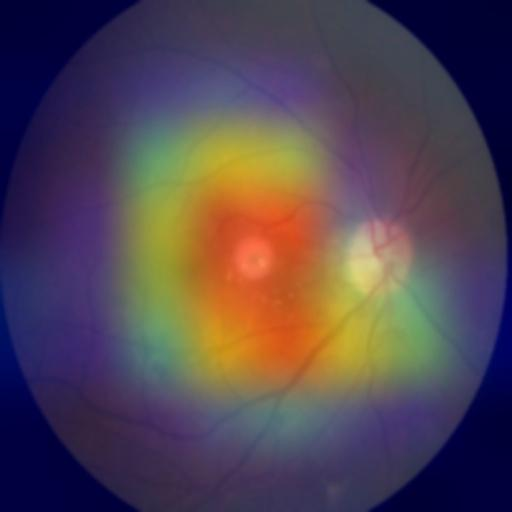

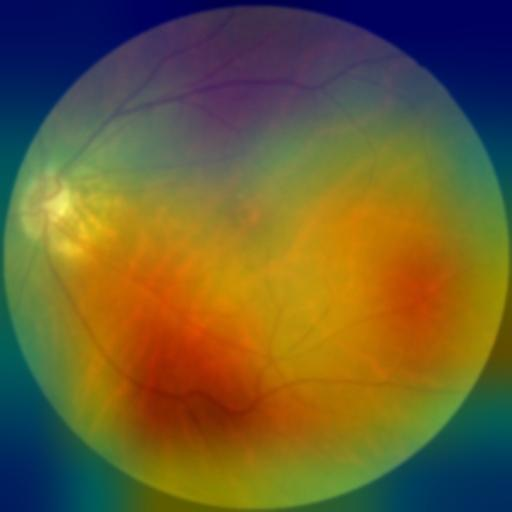

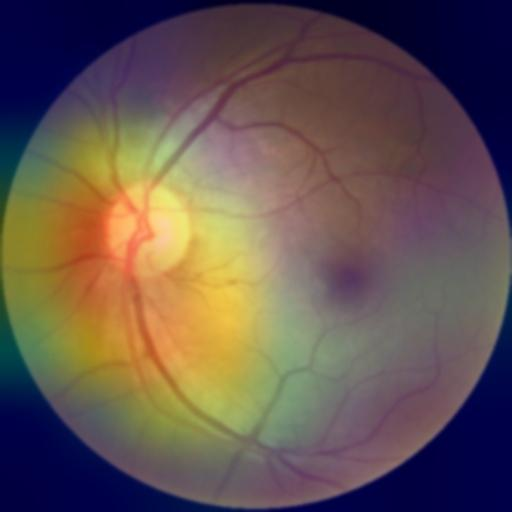

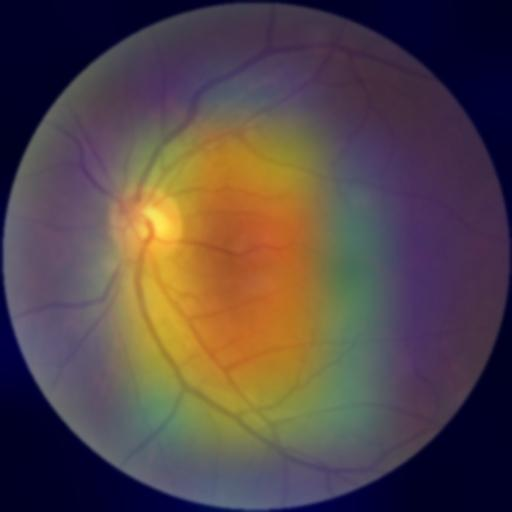

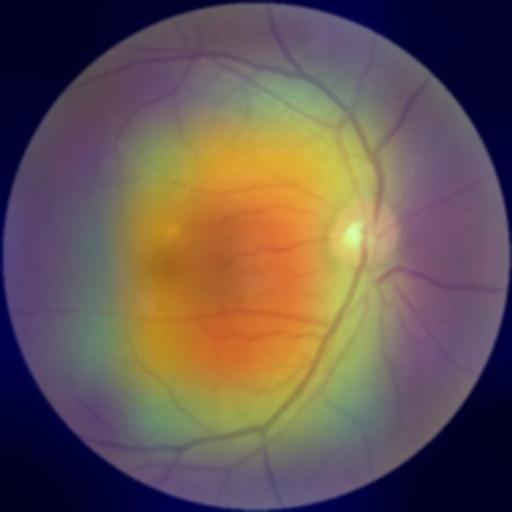

...

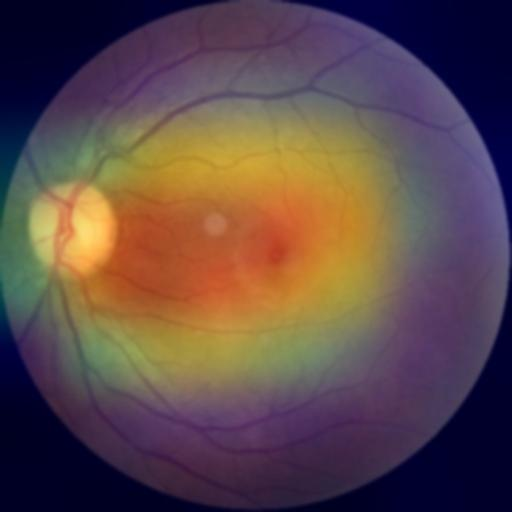

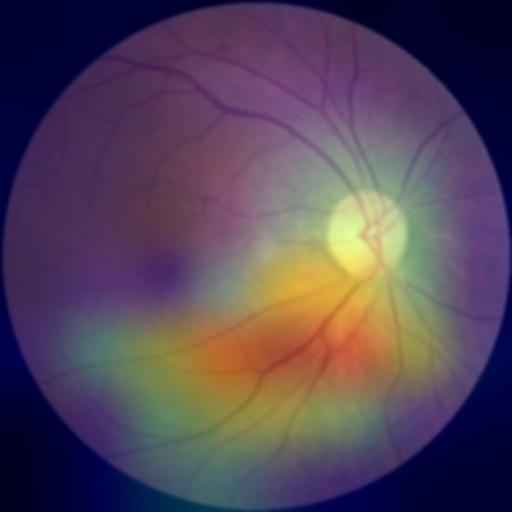

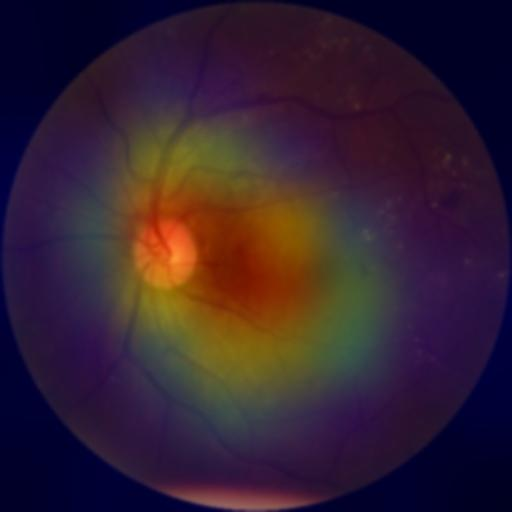

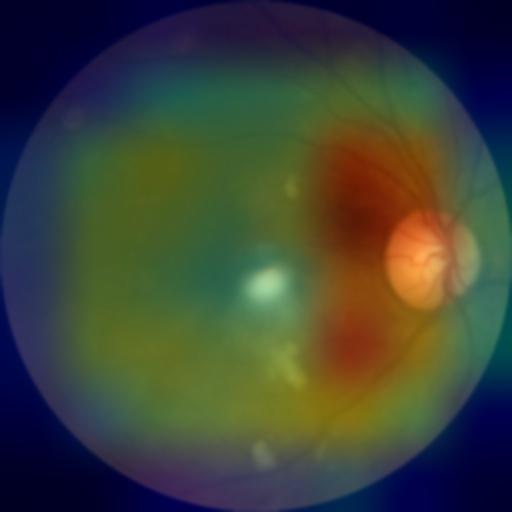

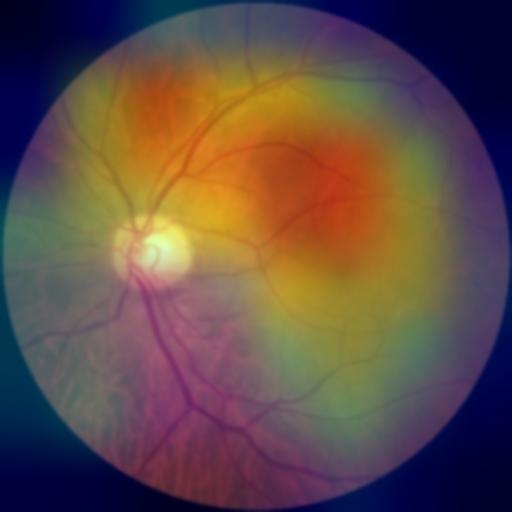

In [ ]:
import tensorflow as tf
import numpy as np
import keras
from keras.preprocessing import image
from keras.applications.inception_v3 import InceptionV3, preprocess_input, decode_predictions
from IPython.display import display, Image
import os
import matplotlib.pyplot as plt
import matplotlib as mpl

model = InceptionV3(weights='imagenet')

last_conv_layer_name = "mixed10"

def get_img_array(img_path, size):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return preprocess_input(array)

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, last_conv_layer_output)

    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()


def save_and_display_gradcam(img_path, heatmap, cam_path="image.jpg", alpha=0.4):
    img = keras.utils.load_img(img_path)
    img = keras.utils.img_to_array(img)
    heatmap = np.uint8(255 * heatmap)

    jet = mpl.cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = keras.utils.array_to_img(superimposed_img)
    superimposed_img.save(cam_path)

    display(Image(cam_path))

images_dir = "/content/drive/MyDrive/MiniProject2/Grad_noise"

def process_images(images_dir, model, last_conv_layer_name, size):
    image_paths = [os.path.join(images_dir, img_name) for img_name in os.listdir(images_dir)]

    for img_path in image_paths:

        img_array = get_img_array(img_path, size)


        heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)
        save_and_display_gradcam(img_path, heatmap)

img_size = (299, 299)

process_images(images_dir, model, last_conv_layer_name, img_size)


# preprocess resnet

In [ ]:
import tensorflow as tf
import numpy as np
import keras
from keras.preprocessing import image
from keras.applications.resnet50 import ResNet50, preprocess_input, decode_predictions
from IPython.display import display, Image
import os
import matplotlib.pyplot as plt
import matplotlib as mpl


model = ResNet50(weights='imagenet')


last_conv_layer_name = "conv5_block3_out"

def get_img_array(img_path, size):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return preprocess_input(array)

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, last_conv_layer_output)

    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()


def save_and_display_gradcam(img_path, heatmap, cam_path="image.jpg", alpha=0.4):
    img = keras.utils.load_img(img_path)
    img = keras.utils.img_to_array(img)
    heatmap = np.uint8(255 * heatmap)

    jet = mpl.cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = keras.utils.array_to_img(superimposed_img)
    superimposed_img.save(cam_path)

    display(Image(cam_path))


images_dir = "/content/drive/MyDrive/MiniProject2/Gradcam"

def process_images(images_dir, model, last_conv_layer_name, size):
    image_paths = [os.path.join(images_dir, img_name) for img_name in os.listdir(images_dir)]

    for img_path in image_paths:

        img_array = get_img_array(img_path, size)


        heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)


        save_and_display_gradcam(img_path, heatmap)

img_size = (224, 224)


process_images(images_dir, model, last_conv_layer_name, img_size)
